# Part 2: Chr21 compartment analysis with transcription

by Pu Zheng and Jun-Han Su

2020.06.06

# Table of contents

>0. [Minimum required packages and settings](#0)
>>
>>0.1: [import required packages](#0.1)
>>
>>0.2: [parameters for plotting](#0.2)
>
>1. [Load data from deposited dataset](#1)
>>
>>1.1 [load chr21 replicate 1](#1.1)
>>
>>1.2 [load chr21 replicate 2](#1.2)
>>
>>1.3 [combine two datasets](#1.3)
>
>2. [Compartment analysis of chr21](#2)
>>
>>2.1 [generate imaging-based median distance and proximity frequency maps](#2.1)
>>
>>2.2 [load corresponding Hi-C map](#2.2)
>>
>>2.3 [call compartments](#2.3)
>
>3. [Analysis of A/B density in single-cells](#3)
>>
>>3.1 [calculate density scores](#3.1)
>>
>>3.2 [median density for chr21](#3.2)
>>
>>3.3 [visualize density in the example chromosome](#3.3)
>>
>>3.4 [calculate segregation scores based on A,B density](#3.4)
>>
>>3.5 [A/B density ratio difference w/wo transcription](#3.5)
>>
>>3.6 [firing rate difference with high/low A/B density ratio](#3.6)
>
>4. [Characterization of compartments in G1, G2/S cells](#4)
>>
>>4.1 [calculate A,B density scores for replicate 2](#4.1)
>>
>>4.2 [calculate segregation scores for G1,G2/S chromosomes](#4.2)


<a id='0'></a>
# 0. Minimum required packages and settings

<a id='0.1'></a>
## 0.1 import required packages

In [1]:
# imports
import os,sys
import numpy as np
import pickle

sys.path.append(os.path.abspath(os.path.join(r"..", r".")))

import source as ia

print(os.getpid()) # print this so u can terminate through cmd / task-manager

36845


In [2]:
%load_ext autoreload
%autoreload 2

<a id='0.2'></a>
## 0.2 parameters for plotting

In [3]:
import matplotlib
import seaborn as sns
sns.set()
from matplotlib import pyplot as plt
from pathlib import Path

slide_width = 11.5
half_slide_width = 5.67
aspect_ratio = 5/7
pres_params = {'axes.edgecolor': 'black',
                  'axes.facecolor':'white',
                  'axes.grid': False,
                  'axes.linewidth': 0.5,
                  'backend': 'ps',
                  'savefig.format': 'pdf',
                  'axes.titlesize': 24,
                  'axes.labelsize': 20,
                  'legend.fontsize': 20,
                  'xtick.labelsize': 18,
                  'ytick.labelsize': 18,
                  'text.usetex': False,
                  'figure.figsize': [half_slide_width, half_slide_width * aspect_ratio],
                  'font.family': 'sans-serif',
                  #'mathtext.fontset': 'cm',
                  'xtick.bottom':True,
                  'xtick.top': False,
                  'xtick.direction': 'out',
                  'xtick.major.pad': 3,
                  'xtick.major.size': 3,
                  'xtick.minor.bottom': False,
                  'xtick.major.width': 0.75,

                  'ytick.left':True,
                  'ytick.right':False,
                  'ytick.direction':'out',
                  'ytick.major.pad': 3,
                  'ytick.major.size': 3,
                  'ytick.major.width': 0.75,
                  'ytick.minor.right':False,
                  'lines.linewidth':2}

plt.rcParams.update(pres_params)
cmap_distance = 'magma'
cmap_temps = 'coolwarm'
cmap_contacts = "YlOrRd"

In [4]:
from matplotlib.ticker import EngFormatter
from matplotlib.colors import LogNorm
import matplotlib.colors as colors

bp_formatter = EngFormatter('b')
norm = LogNorm(vmax=0.1)

def format_ticks(ax, x=True, y=True, rotate=True):
    if y:
        ax.yaxis.set_major_formatter(bp_formatter)
    if x:
        ax.xaxis.set_major_formatter(bp_formatter)
        ax.xaxis.tick_bottom()
    if rotate:
        ax.tick_params(axis='x',rotation=45)

In [4]:
# Required plotting setting
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
import matplotlib.pyplot as plt
plt.rc('font', family='serif')
plt.rc('font', serif='Arial')
_font_size = 7.5

In [5]:
# Required plotting parameters
_dpi = 600 # dpi required by figure
_single_col_width = 2.25 # figure width in inch if occupy 1 colomn
_double_col_width = 4.75 # figure width in inch if occupy 1 colomn
_single_row_height= 2 # comparable height to match single-colomn-width
_ticklabel_size=2
_ticklabel_width=0.5
_font_size=7.5
#from source.figure_tools import _dpi,_single_col_width,_double_col_width,_single_row_height,_ref_bar_length, _ticklabel_size,_ticklabel_width,_font_size

In [73]:
# figure folder
# please specify location to save images
parent_figure_folder = os.path.abspath(os.path.join(r"..", r"..", r"plots"))
figure_folder = os.path.join(parent_figure_folder, 'Chr21_figures')
print(figure_folder)
if not os.path.exists(figure_folder):
    os.makedirs(figure_folder)
    print("generating this folder")

/home/dkannan/git-remotes/chromatin_tracing_analysis/plots/Chr21_figures
generating this folder


<a id='1'></a>
# 1. Load data from deposited dataset

Please visit zenodo with DOI:10.5281/zenodo.3928890

In [5]:
# please change data_folder into the folder for downloaded dataset
data_folder = os.path.abspath(os.path.join(r"..", r"..", r"data"))
print(f"data_folder: {data_folder}")
rep1_filename = os.path.join(data_folder, 'chromosome21.tsv')
rep2_filename = os.path.join(data_folder, 'chromosome21-cell_cycle.tsv')

print(os.path.isfile(rep1_filename), os.path.isfile(rep1_filename))

data_folder: /home/dkannan/git-remotes/chromatin_tracing_analysis/data
True True


<a id='1.1'></a>
## 1.1 load chr21 replicate 1 

(without cell cycle information)

In [6]:
df = pd.read_csv(rep1_filename, '\t')
gene_df = df[df['Gene names'].notnull()]
gene_coords = np.unique(gene_df['Genomic coordinate'])  

NameError: name 'pd' is not defined

In [ ]:
df2 = pd.read_csv(rep2_filename, '\t')

In [247]:
df2

,Z(nm),X(nm),Y(nm),Genomic coordinate,Chromosome copy number,Gene names,Transcription,TSS ZXY(nm),Cell cycle state
0,1205.0,5201.0,15630.0,chr21:10400001-10450001,1,NaN,NaN,NaN,G2/S
1,1280.0,5912.0,16437.0,chr21:10500001-10550001,1,NaN,NaN,NaN,G2/S
2,NaN,NaN,NaN,chr21:10600001-10650001,1,NaN,NaN,NaN,G2/S
3,829.0,5993.0,16856.0,chr21:13250001-13300001,1,NaN,NaN,NaN,G2/S
4,1053.0,5865.0,17703.0,chr21:14000001-14050001,1,NaN,NaN,NaN,G2/S
...,...,...,...,...,...,...,...,...,...
2967253,2020.0,15243.0,12378.0,chr21:46450001-46500001,4558,DIP2A;,on;,[ 1975 15194 11910];,G1
2967254,1971.0,15222.0,12507.0,chr21:46500001-46550001,4558,NaN,NaN,NaN,G1
2967255,1834.0,15339.0,12174.0,chr21:46550001-46600001,4558,NaN,NaN,NaN,G1
2967256,1998.0,15102.0,12409.0,chr21:46600001-46650001,4558,PRMT2;,on;,[ 1999 15077 12246];,G1


In [7]:
#clean up gene coordinates
gene_region_starts = np.array([int(_n.split(':')[1].split('-')[0]) for _n in gene_coords])
gene_region_ends = np.array([int(_n.split(':')[1].split('-')[1]) for _n in gene_coords])
gene_start_position_Mb = np.round(gene_region_starts / 1e6, 2) 

NameError: name 'gene_coords' is not defined

In [243]:
def clean_transcription(row):
    row = str(row)
    if row == '':
        return 0
    _genes = row.split(';')[:-1]
    if "on" in _genes:
        return 1
    return -1

df['gene_state'] = [clean_transcription(s) for s in df['Transcription'].fillna('')]
df

,Z(nm),X(nm),Y(nm),Genomic coordinate,Chromosome copy number,Gene names,Transcription,TSS ZXY(nm),gene_state
0,2449.0,4700.0,7234.0,chr21:10400001-10450001,1,NaN,NaN,NaN,0
1,3731.0,4629.0,7409.0,chr21:10500001-10550001,1,NaN,NaN,NaN,0
2,2248.0,4690.0,7148.0,chr21:10600001-10650001,1,NaN,NaN,NaN,0
3,2211.0,4065.0,7567.0,chr21:13250001-13300001,1,NaN,NaN,NaN,0
4,2499.0,3904.0,7255.0,chr21:14000001-14050001,1,NaN,NaN,NaN,0
...,...,...,...,...,...,...,...,...,...
4941736,3357.0,6909.0,11914.0,chr21:46450001-46500001,7591,DIP2A;,off;,[ 3343 6877 11860];,-1
4941737,3620.0,6634.0,11996.0,chr21:46500001-46550001,7591,NaN,NaN,NaN,0
4941738,3585.0,6728.0,12054.0,chr21:46550001-46600001,7591,NaN,NaN,NaN,0
4941739,3282.0,6442.0,11904.0,chr21:46600001-46650001,7591,PRMT2;,off;,[ 3490 6398 11800];,-1


In [248]:
df2['gene_state'] = [clean_transcription(s) for s in df2['Transcription'].fillna('')]

In [249]:
gene_state = []
for chr_id, data in df.groupby('Chromosome copy number'):
    gene_state.append(data['gene_state'])

#keep appending for replicate 2
for chr_id, data in df2.groupby('Chromosome copy number'):
    gene_state.append(data['gene_state'])
    
gene_state = np.array(gene_state)
gene_state.shape

(12149, 651)

In [7]:
from tqdm.notebook import tqdm

In [8]:


# load from file and extract info
import csv
rep1_info_dict = {}
with open(rep1_filename, 'r') as _handle:
    _reader = csv.reader(_handle, delimiter='\t', quotechar='|')
    _headers = next(_reader)
    print(_headers)
    # create keys for each header
    for _h in _headers:
        rep1_info_dict[_h] = []
    # loop through content
    for _contents in _reader:
        for _h, _info in zip(_headers,_contents):
            rep1_info_dict[_h].append(_info)

# clean up information
data_rep1 = {'params':{}}

# clean up genomic coordiantes
region_names = np.array([_n for _n in sorted(np.unique(rep1_info_dict['Genomic coordinate']), 
                                             key=lambda s:int(s.split(':')[1].split('-')[0]))])
region_starts = np.array([int(_n.split(':')[1].split('-')[0]) for _n in region_names])
region_ends = np.array([int(_n.split(':')[1].split('-')[1]) for _n in region_names])[np.argsort(region_starts)]
region_starts = np.sort(region_starts)

mid_positions = ((region_starts + region_ends)/2).astype(np.int)
mid_positions_Mb = np.round(mid_positions / 1e6, 2) 
start_position_Mb = np.round(region_starts / 1e6, 2) 
end_position_Mb = np.round(region_ends / 1e6, 2) 

# clean up chrom copy number
chr_nums = np.array([int(_info) for _info in rep1_info_dict['Chromosome copy number']])
chr_ids, region_cts = np.unique(chr_nums, return_counts=True)
dna_zxys_list = [[[] for _start in region_starts] for _id in chr_ids]

# clean up zxy
for _z,_x,_y,_reg_info, _cid in tqdm(zip(rep1_info_dict['Z(nm)'],rep1_info_dict['X(nm)'],\
                                         rep1_info_dict['Y(nm)'],rep1_info_dict['Genomic coordinate'],\
                                         rep1_info_dict['Chromosome copy number'])):
    # get chromosome inds
    _cid = int(_cid)
    _cind = np.where(chr_ids == _cid)[0][0]
    
    # get region indices
    _start = int(_reg_info.split(':')[1].split('-')[0])
    _rind = np.where(region_starts==_start)[0][0]
    
    dna_zxys_list[_cind][_rind] = np.array([float(_z),float(_x), float(_y)])

# merge together
dna_zxys_list = np.array(dna_zxys_list)
data_rep1['chrom_ids'] = chr_ids
data_rep1['region_names'] = region_names
data_rep1['mid_position_Mb'] = mid_positions_Mb
data_rep1['start_position_Mb'] = start_position_Mb
data_rep1['end_position_Mb'] = end_position_Mb
data_rep1['dna_zxys'] = dna_zxys_list

# clean up tss and transcription
if 'Gene names' in rep1_info_dict:
    import re
    # first extract number of genes
    gene_names = []
    for _gene_info, _trans_info, _tss_coord in zip(rep1_info_dict['Gene names'],
                                                   rep1_info_dict['Transcription'],
                                                   rep1_info_dict['TSS ZXY(nm)']):
        if _gene_info != '':
            # split by semicolon
            if len(_gene_info.split(';')) > 1:
                print(f'{_gene_info}, {_trans_info}')
            _genes = _gene_info.split(';')[:-1]
            for _gene in _genes:
                if _gene not in gene_names:
                    gene_names.append(_gene)
    print(f"{len(gene_names)} genes exist in this dataset.")
    
    # initialize gene and transcription
    tss_zxys_list = [[[] for _gene in gene_names] for _id in chr_ids]
    transcription_profiles = [[[] for _gene in gene_names] for _id in chr_ids]
    # loop through to get info
    for _cid, _gene_info, _trans_info, _tss_locations in tqdm(zip(rep1_info_dict['Chromosome copy number'],
                                                                  rep1_info_dict['Gene names'],
                                                                  rep1_info_dict['Transcription'],
                                                                  rep1_info_dict['TSS ZXY(nm)'])):
        # get chromosome inds
        _cid = int(_cid)
        _cind = np.where(chr_ids == _cid)[0][0]
        # process if there are genes in this region:
        if _gene_info != '':
            # split by semicolon
            _genes = _gene_info.split(';')[:-1]
            _transcribes = _trans_info.split(';')[:-1]
            _tss_zxys = _tss_locations.split(';')[:-1]
            for _gene, _transcribe, _tss_zxy in zip(_genes, _transcribes, _tss_zxys):
                # get gene index
                _gind = gene_names.index(_gene)
                # get transcription profile
                if _transcribe == 'on':
                    transcription_profiles[_cind][_gind] = True
                else:
                    transcription_profiles[_cind][_gind] = False
                # get coordinates
                _tss_zxy = np.array([np.float(_c) for _c in re.split(r'\s+', _tss_zxy.split('[')[1].split(']')[0]) if _c != ''])
                tss_zxys_list[_cind][_gind] = _tss_zxy
                
    tss_zxys_list = np.array(tss_zxys_list)
    transcription_profiles = np.array(transcription_profiles)
    data_rep1['gene_names'] = gene_names
    data_rep1['tss_zxys'] = tss_zxys_list
    data_rep1['trans_pfs'] = transcription_profiles

# clean up cell_cycle states
if 'Cell cycle state' in rep1_info_dict:
    cell_cycle_types = np.unique(rep1_info_dict['Cell cycle state'])
    cell_cycle_flag_dict = {_k:[[] for _id in chr_ids] for _k in cell_cycle_types if _k != 'ND'}
    for _cid, _state in tqdm(zip(rep1_info_dict['Chromosome copy number'],rep1_info_dict['Cell cycle state'])):
        # get chromosome inds
        _cid = int(_cid)
        _cind = np.where(chr_ids == _cid)[0][0]
        if np.array([_v[_cind]==[] for _k,_v in cell_cycle_flag_dict.items()]).any():
            for _k,_v in cell_cycle_flag_dict.items():
                if _k == _state:
                    _v[_cind] = True
                else:
                    _v[_cind] = False
    # append to data
    for _k, _v in cell_cycle_flag_dict.items():
        data_rep1[f'{_k}_flags'] = np.array(_v)  

['Z(nm)', 'X(nm)', 'Y(nm)', 'Genomic coordinate', 'Chromosome copy number', 'Gene names', 'Transcription', 'TSS ZXY(nm)']


/tmp/ipykernel_20142/563716152.py:28: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mid_positions = ((region_starts + region_ends)/2).astype(np.int)


0it [00:00, ?it/s]

HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, on;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, 

MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;

RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, on;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2

HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, on;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;


SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, on;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;

HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, on;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, on;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;,

LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, on;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
AT

SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, on;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, off;
LTN1;, on;
USP16;, on;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;

CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;

PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;

SCAF4;, off;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, on;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, on;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, on;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, o

SOD1;, off;
SCAF4;, on;
HUNK;, on;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, 

PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, 

ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;

PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, on;
SOD1;, on;
SCAF4;, on;
HUNK;, on;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, on;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, on;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;,

PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3

C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, 

WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, on;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9

APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, on;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG

WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, on;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, 

PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, on;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, of

HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
S

COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, on;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, on;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, on;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, on;
PFKL;, on;
SUMO3;

HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, on;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, on;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, on;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;

SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, 

RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, on;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;

WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, on;
MIS18A;, off;
URB1;, off;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, on;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, on;
BACE2;, off;
MX2;, 

MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NR

SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;o

MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, on;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;

C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;o

AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;

PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, on;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, o

DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC

TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, of

SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, on;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, o

SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off

PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, on;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;

RRP1B;, on;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, on;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD

PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1

PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF

CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on

TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AM

DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, on;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CB

ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, on;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, of

IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, on;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off

CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, 

AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, on;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4

C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off

PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, on;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, 

MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off

MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, on;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP

ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, on;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, of

DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, on;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, 

SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, on;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, on;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, on;
MX1;, off;
PRDM15;, on;
C2C

SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, on;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
E

MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, on;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, 

COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, on;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITG

N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, on;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, on;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;

SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, on;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, of

N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, on;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRP

COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;

COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
A

COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;on;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, on;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB

PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, on;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL

NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;,

C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, on;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
W

MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;

SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, on;
LCA5L;, on;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, of

DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, 

PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, on;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off

COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, on;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off

COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADA

SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, on;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off

IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, on;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1

C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, on;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, on;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA

URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, on;
MORC3;, off;
CHAF1B;, on;
SIM2;, on;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, on;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIA

RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, on;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;,

PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3

PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37

SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, on;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, on;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;,

HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUN

BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, of

COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, on;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, on;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2

PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, on;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, 

RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;,

PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, of

USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, on;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, on;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, 

SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, on;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1

DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, on;
RUNX1;, on;
SETD4;, off;
CBR3;, off;

EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;on;
ATP5PF;, on;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIA

LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL1

CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
AP

PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, on;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, 

RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, on;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;,

C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;

ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, on;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;,

HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, on;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;

HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, on;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, on;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, on;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, of

RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, on;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
W

DIP2A;, on;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;

SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, on;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L

PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, on;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, on;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, on;
PDE9A;, on;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;,

SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM1

MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, on;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, on;
SIM2;, off;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, on;
HMGN1;BRWD1;, off;on;
WRB;, on;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A

MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, on;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, 

MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;

SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, o

IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4

HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;

CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PC

SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;


MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, on;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP

PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, on;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, on;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, on;
P

DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, on;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
C

ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, on;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21o

DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;

IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;


TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, on;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;


USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, on;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, on;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, on;
A

C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, on;
LCA5L;, off;
BACE2;, on;
MX2;, on;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on

RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, 

COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;

MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, on;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, on;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;

PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, 

SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, o

PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, o

ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;

CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, on;
SLC37A1;, on;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;,

MRPS6;, off;
RCAN1;, on;
RUNX1;, on;
SETD4;, on;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, 

PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, on;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;

CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, 

TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, on;

LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK

PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2

CBR3;, off;
MORC3;, off;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SO

SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUM

RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRD

TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;


CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5

DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, on;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;

BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, on;
HLCS;, on;
TTC3;, on;
DSCR9;, on;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT

NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, of

PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, on;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, on;
SIM2;, of

IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
U

BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, o

MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, on;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, on;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, o

WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, on;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;

SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, on;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;

BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, of

MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ET

SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;

COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207

DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, on;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;

RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, 

HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;

RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, on;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IF

LTN1;, on;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, on;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, on;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;of

SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, on;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, of

URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, on;
MORC3;, on;
CHAF1B;, on;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, on;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;

MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, on;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
S

SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, on;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, o

SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMT

MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;


RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, o

MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, on;
SIM2;, on;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HM

COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, on;
SIM2;, on;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, on;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, on;
FAM207A;ITGB2;, o

NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
L

CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, on;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR

CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS

ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, on;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C

HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;

BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;

PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD

BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2

LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, on;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;

RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, on;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL

RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
I

MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;

URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, on;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, on;


LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, on;
DSCR9;, on;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, of

PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, on;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, on;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;


LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, on;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, on;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
CO

HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A

MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2

PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;


COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, on;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
A

USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, on;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP

ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;on;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1

ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21o

COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, on;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;


CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;on;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, on;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6

RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1

PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, on;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, on;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off

HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX

RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD

MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;


PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, on;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1

TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, on;
LCA5L;, on;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAM

FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
T

SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;

CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;

ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off

MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CC

HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;,

MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, on;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1

WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;

MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, o

SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, o

CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, on;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;

PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off

LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;of

SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, of

NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA1

MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, on;
BACE2;, off;
MX2;, off;
MX1;, on;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, on;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, on;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;,

PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, on;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A

ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP

RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off

PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT

MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, of

DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYN

PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;

LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF

DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;

ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;

URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;


COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, on;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, on;
MORC3;, off;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, o

MIS18A;, on;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off

ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;

DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on

IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, on;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, on;
MIS18A;, off;
URB1;, off

MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, on;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;

RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, o

HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;


ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
P

DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, on;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, of

CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, o

PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, on;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;

SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, on;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;,

IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, on;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C

TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, on;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, on;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
C

PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;


USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, 

RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;

RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, on;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD

USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3A

PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, on;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;


HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
CO

C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, on;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PR

CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, on;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DO

TTC3;, off;
DSCR9;, on;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, on;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, on;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off

LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR

HUNK;, on;
MIS18A;, on;
URB1;, off;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;

SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, on;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;

NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HS

FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, of

APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, on;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG

MORC3;, on;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, on;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1

TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKN

URB1;, off;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, on;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
T

DONSON;, on;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAX

IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB

SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
R

USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, on;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, 

ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, on;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CH

APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, on;
BTG3;, off;
C21

COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, on;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207

PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, on;
MORC3;, on;
CHAF1B;, of

USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, o

MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFN

NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;,

PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, on;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, of

C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, on;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, o

C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, on;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, on;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;,

HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, on;
RUNX1;, on;
S

LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;,

ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MR

C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;

LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
A

NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSP

SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT

PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, on;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, on;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, on;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, 

PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, on;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;


NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, o

USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, on;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, o

ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, on;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;,

TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, on;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;

PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;

ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, on;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, on;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCA

SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;

N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRP

MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, on;
BACE2;, off;
MX2;, on;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
U

PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, on;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, on;
SIM2;, off;
H

IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;

MCM3AP;, off;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, on;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, on;
DONSON;, on;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SL

PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, on;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP

PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, on;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, on;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, on;
LCA5L;, on;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, o

RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, on;
SLC37A1;, off;
PD

C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, off;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, on;
DIP2A;, on;
PRMT2;

PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, on;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, 

PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, on;on;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC

MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, on;
URB1;, on;
EVA1C;, on;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, on;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, on;
SIM2;, on;
HLCS;, on;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;B

ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, o

PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, on;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, on;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;


SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, 

WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, on;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off

CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, of

MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, on;
RRP1B;, on;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;

APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, on;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BT

SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, on;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, on;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, 

SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, on;
MORC3;, off;
CHAF1B;, off;
SIM2;, on;
HLCS;, off;
TTC3;, off;
DSCR9;, on;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, on;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SY

MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;,

C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on

SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;,

DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, on;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3

SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, on;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;

IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, on;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, on;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, on;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;,

PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SL

HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, on;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, on;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, on;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8

PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;on;
ATP5PF;, on;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, on;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, on;
BACE2;, off;
MX2;, on;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;

HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, on;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, on;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
CO

MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFN

LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, on;
DYRK1A;, off;
ETS2;, on;
PSMG1;, on;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, on;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, on;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off

HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HL

BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, on;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, on;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, on;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, on;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;,

LSS;, on;
MCM3AP;, on;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, on;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;,

HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, on;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, on;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, on;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
U

APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, on;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, on;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, on;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, of

PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, on;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, off;
HUNK;, on;
MIS18A;, on;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, on;
IFNAR2;, off;
IL10RB;, on;
IFNAR1;, on;
SON;, on;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, on;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, on;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;on;
PTTG1IP;, on;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;

IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, on;
MRPS6;, off;
RCAN1;, off;
RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, on;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, on;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, on;
BACE2;, on;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, on;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, o

N6AMT1;, on;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, on;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, off;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;,

RUNX1;, on;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, on;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, on;
SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, on;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, on;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, on;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, on;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, on;
IFNAR

AGPAT3;, on;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, on;on;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, on;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, on;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2CD2;, off;
SLC37A1;, on;
PDE9A;, off;
W

SIK1;, off;
RRP1B;, off;
PDXK;, on;
RRP1;, off;
AGPAT3;, on;
TRAPPC10;, off;
PWP2;, on;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, on;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, on;
LSS;, on;
MCM3AP;, off;
PCNT;, on;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, on;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, on;
IFNAR1;, on;
SON;, off;
DONSON;, on;
CRYZL1;, off;
MRPS6;, on;
RCAN1;, off;
RUNX1;, on;
SETD4;, on;
CBR3;, off;
MORC3;, on;
CHAF1B;, off;
SIM2;, on;
HLCS;, off;
TTC3;, on;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;on;
WRB;, off;
LCA5L;, on;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, off;
C2C

AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, off;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, off;
COL6A1;, off;
COL6A2;, off;
LSS;, off;
MCM3AP;, off;
PCNT;, on;
DIP2A;, off;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, off;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, on;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, on;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, off;
SCAF4;, off;
HUNK;, off;
MIS18A;, off;
URB1;, on;
EVA1C;, off;
SYNJ1;, on;
PAXBP1;, off;
IFNAR2;, on;
IL10RB;, off;
IFNAR1;, off;
SON;, off;
DONSON;, off;
CRYZL1;, on;
MRPS6;, on;
RCAN1;, off;
RUNX1;, off;
SETD4;, on;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, on;
PSMG1;, off;
HMGN1;BRWD1;, off;off;
WRB;, off;
LCA5L;, off;
BACE2;, off;
MX2;, off;
MX1;, off;
PRDM15;, on;
C2CD2;, on;
SLC37A1;, off;
PDE9A;, of

PRDM15;, off;
C2CD2;, off;
SLC37A1;, off;
PDE9A;, off;
WDR4;, off;
PKNOX1;, off;
SIK1;, off;
RRP1B;, off;
PDXK;, off;
RRP1;, off;
AGPAT3;, off;
TRAPPC10;, off;
PWP2;, off;
PFKL;, off;
SUMO3;UBE2G2;, off;off;
PTTG1IP;, on;
FAM207A;ITGB2;, off;off;
ADARB1;, off;
COL18A1;, off;
SLC19A1;, off;
PCBP3;, on;
COL6A1;, on;
COL6A2;, on;
LSS;, on;
MCM3AP;, on;
PCNT;, off;
DIP2A;, on;
PRMT2;, off;
HSPA13;, off;
NRIP1;, off;
USP25;, off;
CXADR;, off;
BTG3;, off;
C21orf91;, on;
NCAM2;, off;
MRPL39;JAM2;, off;off;
ATP5PF;, off;
APP;, off;
ADAMTS1;, off;
ADAMTS5;, off;
N6AMT1;, off;
LTN1;, off;
USP16;, off;
CCT8;, off;
BACH1;, off;
TIAM1;, off;
SOD1;, on;
SCAF4;, on;
HUNK;, off;
MIS18A;, off;
URB1;, off;
EVA1C;, off;
SYNJ1;, off;
PAXBP1;, off;
IFNAR2;, off;
IL10RB;, off;
IFNAR1;, on;
SON;, off;
DONSON;, off;
CRYZL1;, off;
MRPS6;, off;
RCAN1;, off;
RUNX1;, off;
SETD4;, off;
CBR3;, off;
MORC3;, off;
CHAF1B;, off;
SIM2;, off;
HLCS;, off;
TTC3;, off;
DSCR9;, off;
DYRK1A;, off;
ETS2;, off;
PSMG1;, off;
HMG

0it [00:00, ?it/s]

/tmp/ipykernel_20142/563716152.py:105: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  _tss_zxy = np.array([np.float(_c) for _c in re.split(r'\s+', _tss_zxy.split('[')[1].split(']')[0]) if _c != ''])


In [203]:
len(rep1_info_dict['Gene names'])

4941741

In [177]:
data_rep1.keys()

dict_keys(['params', 'chrom_ids', 'region_names', 'mid_position_Mb', 'start_position_Mb', 'end_position_Mb', 'dna_zxys', 'gene_names', 'tss_zxys', 'trans_pfs'])

In [ ]:
for _cid, _gene_info, _trans_info, _tss_locations in tqdm(zip(rep1_info_dict['Chromosome copy number'],
                                                              rep1_info_dict['
                                                                  rep1_info_dict['Gene names'],
                                                                  rep1_info_dict['Transcription'],
                                                                  rep1_info_dict['TSS ZXY(nm)'])):
        # get chromosome inds
        _cid = int(_cid)
        _cind = np.where(chr_ids == _cid)[0][0]
        # process if there are genes in this region:
        if _gene_info != '':
            # split by semicolon
            _genes = _gene_info.split(';')[:-1]
            _transcribes = _trans_info.split(';')[:-1]
            _tss_zxys = _tss_locations.split(';')[:-1]
            for _gene, _transcribe, _tss_zxy in zip(_genes, _transcribes, _tss_zxys):
                # get gene index
                _gind = gene_names.index(_gene)
                # get transcription profile
                if _transcribe == 'on':
                    transcription_profiles[_cind][_gind] = True
                else:
                    transcription_profiles[_cind][_gind] = False
                # get coordinates
                _tss_zxy = np.array([np.float(_c) for _c in re.split(r'\s+', _tss_zxy.split('[')[1].split(']')[0]) if _c != ''])
                tss_zxys_list[_cind][_gind] = _tss_zxy
                
    tss_zxys_list = np.array(tss_zxys_list)
    transcription_profiles = np.array(transcription_profiles)

<a id='1.2'></a>
## 1.2 load chr21 replicate 2 

(with cell cycle information)

In [9]:
from tqdm.notebook import tqdm

# load from file and extract info
import csv
rep2_info_dict = {}
with open(rep2_filename, 'r') as _handle:
    _reader = csv.reader(_handle, delimiter='\t', quotechar='|')
    _headers = next(_reader)
    print(_headers)
    # create keys for each header
    for _h in _headers:
        rep2_info_dict[_h] = []
    # loop through content
    for _contents in _reader:
        for _h, _info in zip(_headers,_contents):
            rep2_info_dict[_h].append(_info)

# clean up information
data_rep2 = {'params':{}}

# clean up genomic coordiantes
region_names = np.array([_n for _n in sorted(np.unique(rep2_info_dict['Genomic coordinate']), 
                                             key=lambda s:int(s.split(':')[1].split('-')[0]))])
region_starts = np.array([int(_n.split(':')[1].split('-')[0]) for _n in region_names])
region_ends = np.array([int(_n.split(':')[1].split('-')[1]) for _n in region_names])[np.argsort(region_starts)]
region_starts = np.sort(region_starts)

mid_positions = ((region_starts + region_ends)/2).astype(int)
mid_positions_Mb = np.round(mid_positions / 1e6, 2) 
start_position_Mb = np.round(region_starts / 1e6, 2) 
end_position_Mb = np.round(region_ends / 1e6, 2) 

# clean up chrom copy number
chr_nums = np.array([int(_info) for _info in rep2_info_dict['Chromosome copy number']])
chr_ids, region_cts = np.unique(chr_nums, return_counts=True)
dna_zxys_list = [[[] for _start in region_starts] for _id in chr_ids]

# clean up zxy
for _z,_x,_y,_reg_info, _cid in tqdm(zip(rep2_info_dict['Z(nm)'],rep2_info_dict['X(nm)'],\
                                         rep2_info_dict['Y(nm)'],rep2_info_dict['Genomic coordinate'],\
                                         rep2_info_dict['Chromosome copy number'])):
    # get chromosome inds
    _cid = int(_cid)
    _cind = np.where(chr_ids == _cid)[0][0]
    
    # get region indices
    _start = int(_reg_info.split(':')[1].split('-')[0])
    _rind = np.where(region_starts==_start)[0][0]
    
    dna_zxys_list[_cind][_rind] = np.array([float(_z),float(_x), float(_y)])

# merge together
dna_zxys_list = np.array(dna_zxys_list)
data_rep2['chrom_ids'] = chr_ids
data_rep2['region_names'] = region_names
data_rep2['mid_position_Mb'] = mid_positions_Mb
data_rep2['start_position_Mb'] = start_position_Mb
data_rep2['end_position_Mb'] = end_position_Mb
data_rep2['dna_zxys'] = dna_zxys_list

# clean up tss and transcription
if 'Gene names' in rep2_info_dict:
    import re
    # first extract number of genes
    gene_names = []
    for _gene_info, _trans_info, _tss_coord in zip(rep2_info_dict['Gene names'],
                                                   rep2_info_dict['Transcription'],
                                                   rep2_info_dict['TSS ZXY(nm)']):
        if _gene_info != '':
            # split by semicolon
            _genes = _gene_info.split(';')[:-1]
            for _gene in _genes:
                if _gene not in gene_names:
                    gene_names.append(_gene)
    print(f"{len(gene_names)} genes exist in this dataset.")
    
    # initialize gene and transcription
    tss_zxys_list = [[[] for _gene in gene_names] for _id in chr_ids]
    transcription_profiles = [[[] for _gene in gene_names] for _id in chr_ids]
    # loop through to get info
    for _cid, _gene_info, _trans_info, _tss_locations in tqdm(zip(rep2_info_dict['Chromosome copy number'],
                                                                  rep2_info_dict['Gene names'],
                                                                  rep2_info_dict['Transcription'],
                                                                  rep2_info_dict['TSS ZXY(nm)'])):
        # get chromosome inds
        _cid = int(_cid)
        _cind = np.where(chr_ids == _cid)[0][0]
        # process if there are genes in this region:
        if _gene_info != '':
            # split by semicolon
            _genes = _gene_info.split(';')[:-1]
            _transcribes = _trans_info.split(';')[:-1]
            _tss_zxys = _tss_locations.split(';')[:-1]
            for _gene, _transcribe, _tss_zxy in zip(_genes, _transcribes, _tss_zxys):
                # get gene index
                _gind = gene_names.index(_gene)
                # get transcription profile
                if _transcribe == 'on':
                    transcription_profiles[_cind][_gind] = True
                else:
                    transcription_profiles[_cind][_gind] = False
                # get coordinates
                _tss_zxy = np.array([np.float(_c) for _c in re.split(r'\s+', _tss_zxy.split('[')[1].split(']')[0]) if _c != ''])
                tss_zxys_list[_cind][_gind] = _tss_zxy
                
    tss_zxys_list = np.array(tss_zxys_list)
    transcription_profiles = np.array(transcription_profiles)
    data_rep2['gene_names'] = gene_names
    data_rep2['tss_zxys'] = tss_zxys_list
    data_rep2['trans_pfs'] = transcription_profiles

# clean up cell_cycle states
if 'Cell cycle state' in rep2_info_dict:
    cell_cycle_types = np.unique(rep2_info_dict['Cell cycle state'])
    cell_cycle_flag_dict = {_k:[[] for _id in chr_ids] for _k in cell_cycle_types if _k != 'ND'}
    for _cid, _state in tqdm(zip(rep2_info_dict['Chromosome copy number'],rep2_info_dict['Cell cycle state'])):
        # get chromosome inds
        _cid = int(_cid)
        _cind = np.where(chr_ids == _cid)[0][0]
        if np.array([_v[_cind]==[] for _k,_v in cell_cycle_flag_dict.items()]).any():
            for _k,_v in cell_cycle_flag_dict.items():
                if _k == _state:
                    _v[_cind] = True
                else:
                    _v[_cind] = False
    # append to data
    for _k, _v in cell_cycle_flag_dict.items():
        data_rep2[f'{_k}_flags'] = np.array(_v)  

['Z(nm)', 'X(nm)', 'Y(nm)', 'Genomic coordinate', 'Chromosome copy number', 'Gene names', 'Transcription', 'TSS ZXY(nm)', 'Cell cycle state']


0it [00:00, ?it/s]

84 genes exist in this dataset.


0it [00:00, ?it/s]

/tmp/ipykernel_20142/3376419231.py:103: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  _tss_zxy = np.array([np.float(_c) for _c in re.split(r'\s+', _tss_zxy.split('[')[1].split(']')[0]) if _c != ''])


0it [00:00, ?it/s]

<a id='1.3'></a>
## 1.3 combine two datasets

in most of panels we combined chromosomes from two replicates for better statistics

In [10]:
data_rep2['dna_zxys'].shape

(4558, 651, 3)

In [11]:
data_combined = {}
for _k in data_rep1:
    if _k in data_rep2:
        # concatenate if this is some chromosomal data
        if len(data_rep1[_k]) == len(data_rep1["chrom_ids"]):
            data_combined[_k] = np.concatenate([data_rep1[_k],data_rep2[_k]])
        # directly merge if this is some shared information
        elif (np.array(data_rep1[_k]) == np.array(data_rep2[_k])).all():
            data_combined[_k] = data_rep1[_k]
            
print('Number of chromosomes:', len(data_combined['chrom_ids']))

Number of chromosomes: 12149


In [12]:
data_combined.keys()

dict_keys(['params', 'chrom_ids', 'region_names', 'mid_position_Mb', 'start_position_Mb', 'end_position_Mb', 'dna_zxys', 'gene_names', 'tss_zxys', 'trans_pfs'])

In [252]:
data_combined['gene_state'] = gene_state

<a id='2'></a>
# 2. Compartment analysis of chr21

<a id='2.1'></a>
## 2.1 generate imaging-based median distance and proximity frequency maps

In [13]:
%matplotlib inline

In [8]:
from scipy.spatial.distance import pdist, squareform
zxys_combined_list = np.array(data_combined['dna_zxys'])
zxys_combined_list = np.array([squareform(pdist(_zxy)) for _zxy in tqdm(zxys_combined_list)])

# generate median distance map
median_distance_map_combined = np.nanmedian(zxys_combined_list, axis = 0)
# generate contact map
contact_th = 500
contact_map_combined = np.sum(zxys_combined_list<contact_th, axis=0) / np.sum(np.isnan(zxys_combined_list)==False, axis=0)# load Hi-C

  0%|          | 0/12149 [00:00<?, ?it/s]

MemoryError: Unable to allocate 38.4 GiB for an array with shape (12149, 651, 651) and data type float64

In [ ]:
rirjmap_combined_list = np.array([squareform(pdist(_zxy, lambda u,v: np.dot(u,v))) for _zxy in tqdm(zxys_combined_list)])

In [ ]:
zxys_combined_list[0].shape

In [ ]:
#only compute Q for structures where over 99% of loci are mapped
mapped_fraction = 0.99
max_nan_fraction = 1.0 - mapped_fraction
zxys_filtered = []
for zxy in zxys_combined_list:
    num_nans = np.any(np.isnan(zxy), axis=1).sum()
    if (num_nans / 651) < max_nan_fraction:
        zxys_filtered.append(zxy)

In [12]:
with open('zxys_filtered.pkl', 'rb') as f:
    zxys_filtered = pickle.load(f)

In [15]:
zxys_filtered[0].shape

(651, 3)

In [18]:
%matplotlib inline

Mean radius of gyration: 862.122232494294 nm


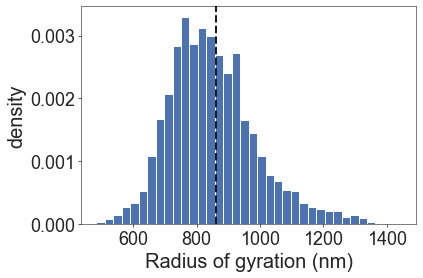

In [19]:
#radius of gyration histogram
Rg2 = []
for i in range(len(zxys_filtered)):
    posN = zxys_filtered[i]
    Rg2.append(np.nanmean((posN - np.nanmean(posN, axis=0))**2) * 3)
meanRg2 = np.mean(Rg2)
print(f'Mean radius of gyration: {np.sqrt(meanRg2)} nm')
fig, ax = plt.subplots()
result = ax.hist(np.sqrt(Rg2), bins='auto', density=True)
plt.axvline(np.sqrt(meanRg2), color='k', linestyle='dashed')
ax.set_xlabel('Radius of gyration (nm)')
ax.set_ylabel('density')
plt.show()

In [142]:
with open('zxys_filtered.pkl', 'wb') as f:
    pickle.dump(zxys_filtered, f)

In [5]:
with open('data_combined_chr21.pkl', 'rb') as f:
    data_combined = pickle.load(f)

In [140]:
from variability import Q_factor_parallel

In [272]:
import pandas as pd
df = pd.read_csv("data/Q_chr21.csv")
df2 = pd.read_csv("data/Q_chr2.csv")

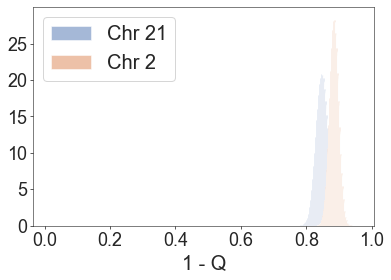

In [273]:
fig, ax = plt.subplots()
n, bins, patches = ax.hist(1.0 - df['Q'], bins="auto", alpha=0.5, density=True, label='Chr 21')
n, bins, patches = ax.hist(1.0 - df2['Q'], bins="auto", alpha=0.5, density=True, label='Chr 2')
plt.legend()
ax.set_xlabel('1 - Q')
fig.tight_layout()
plt.savefig('../../plots/histogram_Qvals_chr21_chr2.pdf')

In [ ]:
msd_map_combined_list = np.array([squareform(pdist(_zxy, metric='sqeuclidean')) for _zxy in tqdm(zxys_combined_list)])

In [270]:
distmap_combined_list[0].shape

(651, 651)

In [ ]:
msd_map_combined = np.nanmean(msd_map_combined_list, axis = 0)

In [22]:
#plot mean distance map for chromosome 21 using combined data set
def plot_msd_map(dist, filename, relative=False, squared=False):
    """ Plot seaborn heatmap where entry (i, j) is the mean distance between beads i and j.
    This version does not include a color bar showing the activity of the monomers.

    Parameters
    ----------
    dist : array-like (N, N)
        matrix containing pairwise mean squared distances between N monomers
    simdir : str or Path
        path to simulation directory containing raw data from which `dist` was computed
    relative : bool
        whether `dist` contains the difference between msds of `simdir` and a reference (eq)
    squared : bool
        whether `dist` contains mean squared distances as opposed to mean distances
    """
    fig, ax = plt.subplots()
    im = plt.imshow(dist, cmap=cmap_distance,
                   extent=[data_combined['start_position_Mb'][0]*10**6, data_combined['end_position_Mb'][-1]*10**6,
                          data_combined['start_position_Mb'][0]*10**6, data_combined['end_position_Mb'][-1]*10**6])
    plt.colorbar(im)
    ax.set_xticks([15*10**6, 25*10**6, 35*10**6, 45*10**6])
    ax.set_yticks([15*10**6, 25*10**6, 35*10**6, 45*10**6])
    format_ticks(ax)
    ax.set_title('Chr 21 Mean Distance', fontsize=18)
    fig.tight_layout()
    if relative:
        plt.savefig(f'../../plots/mean_distance_map_{filename}_relative.pdf')
    else:
        plt.savefig(f'../../plots/mean_distance_map_{filename}.pdf')

#plot mean distance map for chromosome 21 using combined data set
def plot_contact_map(dist, filename, relative=False, squared=False):
    """ Plot seaborn heatmap where entry (i, j) is the mean distance between beads i and j.
    This version does not include a color bar showing the activity of the monomers.

    Parameters
    ----------
    dist : array-like (N, N)
        matrix containing pairwise mean squared distances between N monomers
    simdir : str or Path
        path to simulation directory containing raw data from which `dist` was computed
    relative : bool
        whether `dist` contains the difference between msds of `simdir` and a reference (eq)
    squared : bool
        whether `dist` contains mean squared distances as opposed to mean distances
    """
    fig, ax = plt.subplots()
    lognorm = LogNorm(vmin=dist.min(), vmax=dist.max())
    im = plt.imshow(dist, cmap=cmap_contacts, norm=lognorm,
                   extent=[data_combined['start_position_Mb'][0]*10**6, data_combined['end_position_Mb'][-1]*10**6,
                          data_combined['start_position_Mb'][0]*10**6, data_combined['end_position_Mb'][-1]*10**6])
    plt.colorbar(im)
    ax.set_xticks([15*10**6, 25*10**6, 35*10**6, 45*10**6])
    ax.set_yticks([15*10**6, 25*10**6, 35*10**6, 45*10**6])
    format_ticks(ax)
    ax.set_title('Chr 21 Contact Map', fontsize=18)
    fig.tight_layout()
    if relative:
        plt.savefig(f'../../plots/contact_map_{filename}_relative.pdf')
    else:
        plt.savefig(f'../../plots/contact_map_{filename}.pdf')

<IPython.core.display.Javascript object>


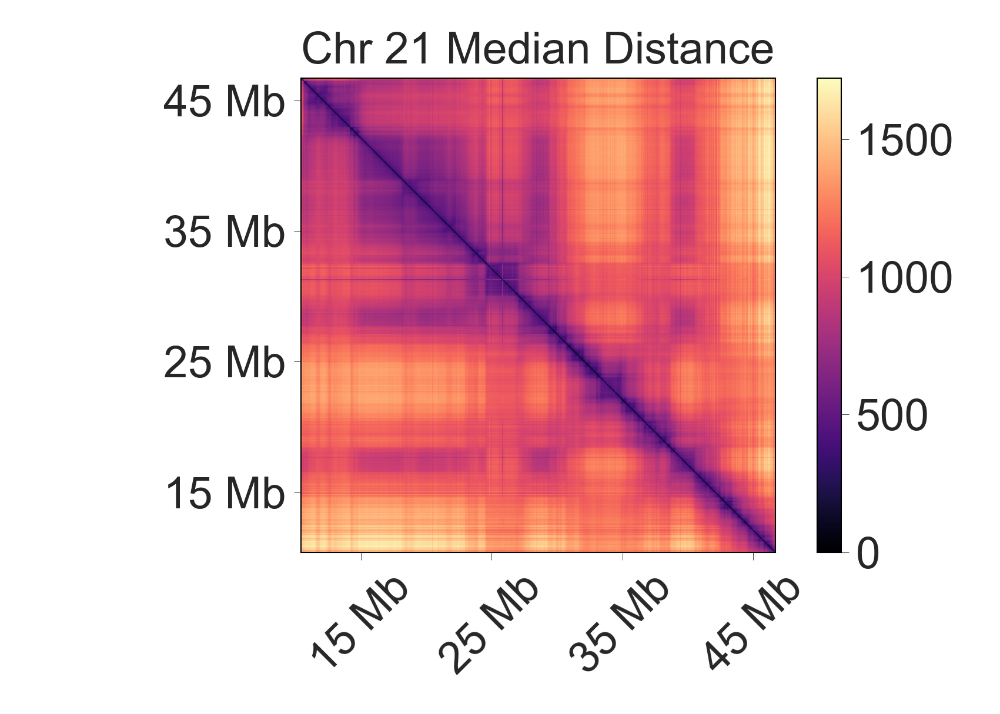

In [70]:
plot_msd_map(median_distance_map_combined, 'chr21_combined')

In [23]:
mean_distance_map_combined = np.nanmean(distmap_combined_list, axis = 0)

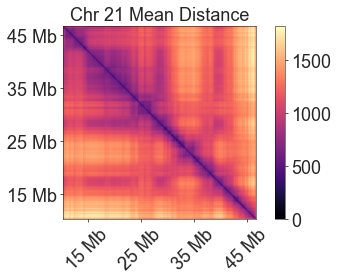

In [31]:
plot_msd_map(mean_distance_map_combined, 'chr21_combined')

In [57]:
np.count_nonzero(np.isnan(distmap_combined_list[1100]))

26880

<IPython.core.display.Javascript object>


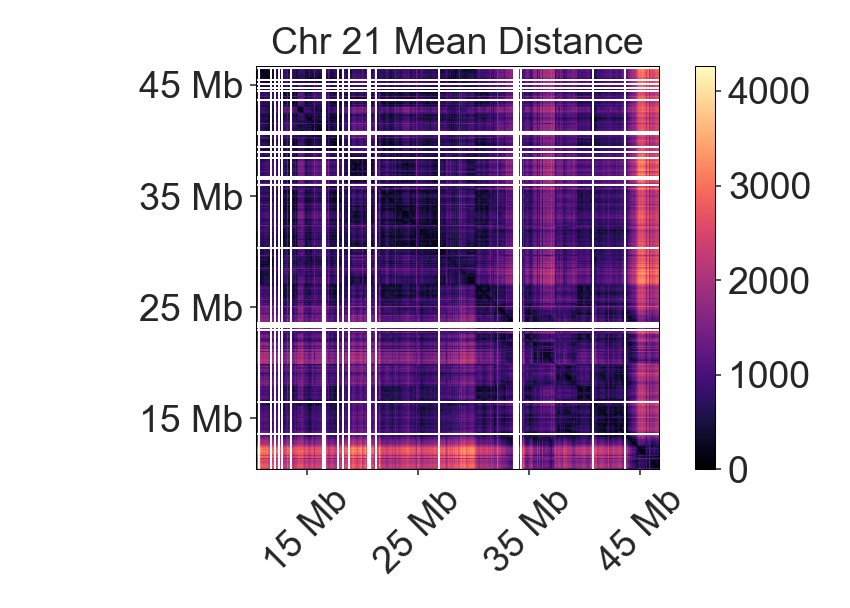

In [236]:
plot_msd_map(distmap_combined_list[1100], 'chr21_cell100')

<IPython.core.display.Javascript object>


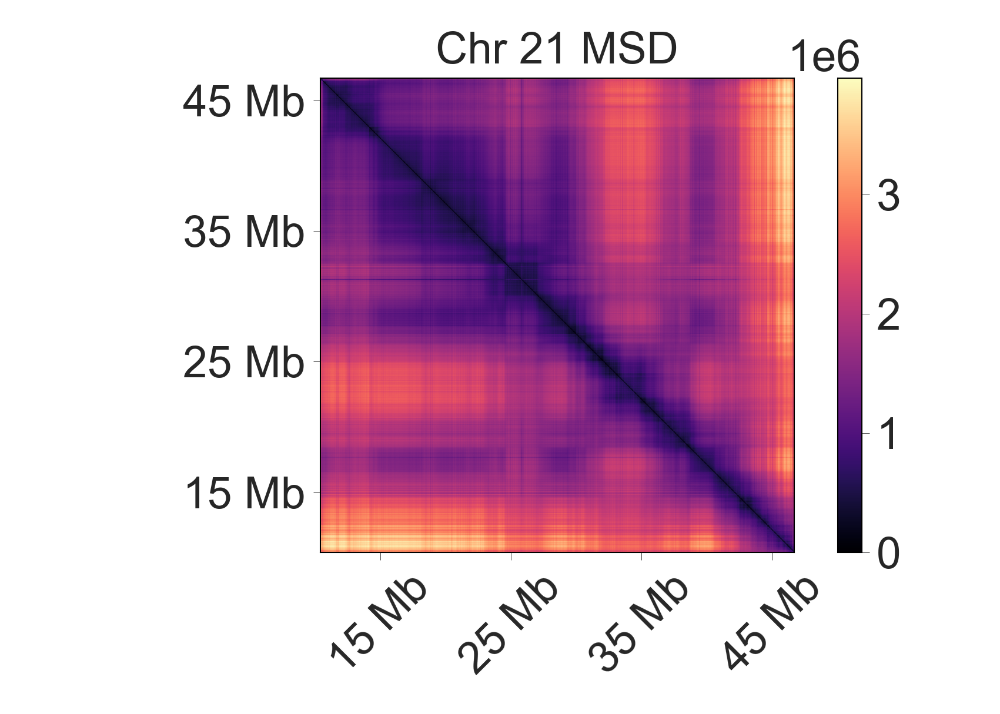

In [123]:
plot_msd_map(msd_map_combined, 'chr21_combined')

<IPython.core.display.Javascript object>


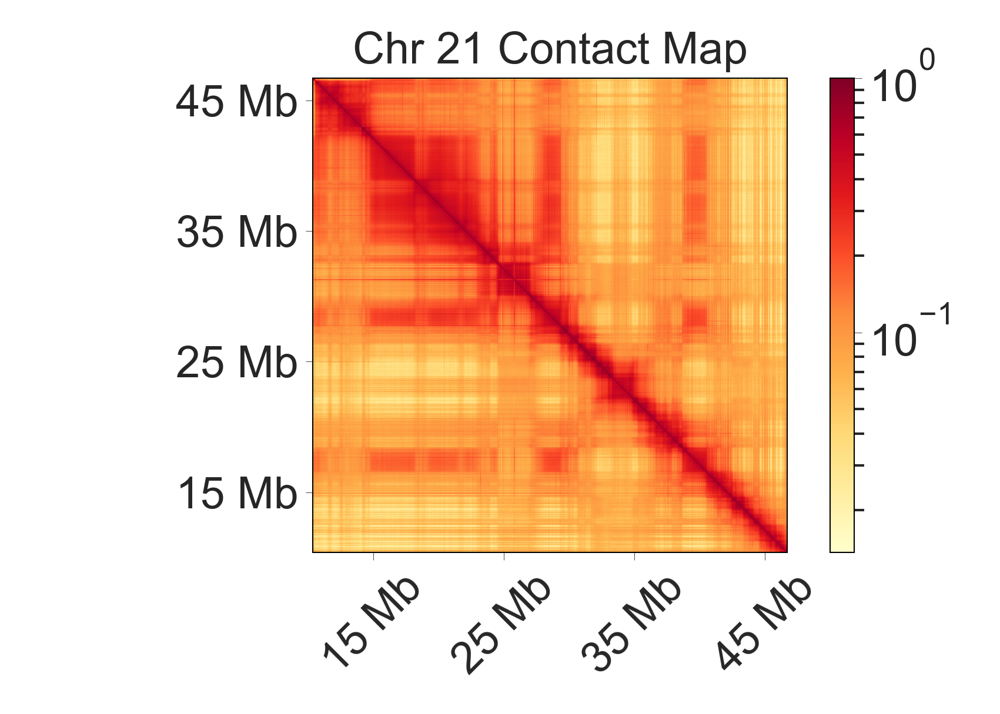

In [90]:
plot_contact_map(contact_map_combined, 'chr21_combined')

<IPython.core.display.Javascript object>


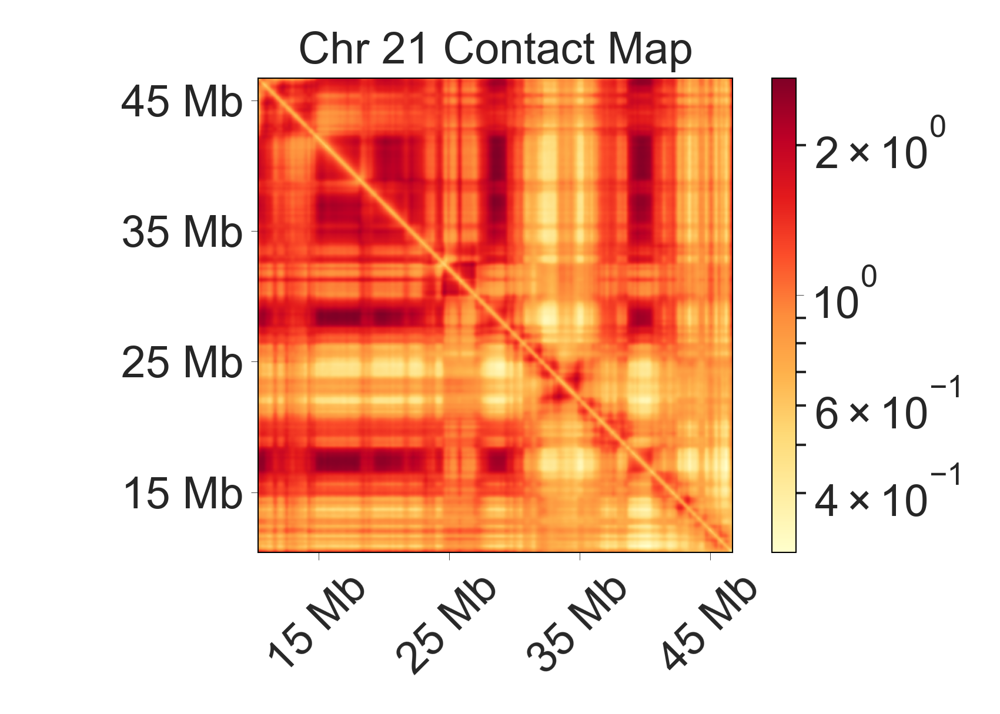

In [157]:
plot_contact_map(gaussian_filter(contact_normed_map, contact_gaussian_sigma), 'chr21_filtered')

In [33]:
# plot mean squared distance as a function of sequence coordinate
def obs_over_exp(contacts):
    """ Computing contact probability as a function of distance from diagonal.

    Parameters
    ----------
    counts : array-like (N, N)
        raw integer counts of contacts between pairs of monomers
    nreplicates : int
        total number of simulation snapshots used to compute ensemble average

    Returns
    -------
    Ploop : array-like (N,)
        contact probabilities (averaged over diagonal of contact map)
    sdistances : array-like (N,)
        distances along chain in Kuhn lengths
    nreplicates : int

    """
    N, _ = contacts.shape
    sdistances = np.arange(0.0, N)
    Ploop = np.zeros_like(sdistances)
    for i in range(N):
        Ploop[i] = np.mean(np.diagonal(contacts, offset=i))
    return Ploop

In [80]:
counts = np.sum(np.isnan(distmap_combined_list)==False, axis=0)
counts

array([[12149, 10465,  8862, ..., 10009,  9865, 10407],
       [10465, 12149,  8929, ..., 10065,  9937, 10462],
       [ 8862,  8929, 12149, ...,  8511,  8382,  8838],
       ...,
       [10009, 10065,  8511, ..., 12149,  9940, 10283],
       [ 9865,  9937,  8382, ...,  9940, 12149, 10170],
       [10407, 10462,  8838, ..., 10283, 10170, 12149]])

In [82]:
contacts = np.sum(distmap_combined_list<contact_th, axis=0)
contacts

array([[12149,  3332,  2454, ...,   475,   379,   846],
       [ 3332, 12149,  3687, ...,   835,   498,  1099],
       [ 2454,  3687, 12149, ...,   627,   439,   951],
       ...,
       [  475,   835,   627, ..., 12149,  5087,  3915],
       [  379,   498,   439, ...,  5087, 12149,  3935],
       [  846,  1099,   951, ...,  3915,  3935, 12149]])

In [108]:
np.cumsum(np.diff(data_combined['mid_position_Mb']))

array([ 0.1 ,  0.2 ,  2.85,  3.6 ,  3.65,  3.7 ,  3.75,  3.8 ,  3.85,
        3.9 ,  3.95,  4.  ,  4.05,  4.1 ,  4.15,  4.2 ,  4.25,  4.3 ,
        4.35,  4.4 ,  4.45,  4.5 ,  4.55,  4.6 ,  4.65,  4.7 ,  4.75,
        4.8 ,  4.85,  4.9 ,  4.95,  5.  ,  5.05,  5.1 ,  5.15,  5.2 ,
        5.25,  5.3 ,  5.35,  5.4 ,  5.45,  5.5 ,  5.55,  5.6 ,  5.65,
        5.7 ,  5.75,  5.8 ,  5.85,  5.9 ,  5.95,  6.  ,  6.05,  6.1 ,
        6.15,  6.2 ,  6.25,  6.3 ,  6.35,  6.4 ,  6.45,  6.5 ,  6.55,
        6.6 ,  6.65,  6.7 ,  6.95,  7.  ,  7.05,  7.1 ,  7.15,  7.2 ,
        7.25,  7.3 ,  7.35,  7.4 ,  7.45,  7.5 ,  7.55,  7.6 ,  7.65,
        7.7 ,  7.75,  7.8 ,  7.85,  7.9 ,  7.95,  8.  ,  8.05,  8.1 ,
        8.15,  8.2 ,  8.25,  8.3 ,  8.35,  8.4 ,  8.45,  8.5 ,  8.55,
        8.6 ,  8.65,  8.7 ,  8.75,  8.8 ,  8.85,  8.9 ,  8.95,  9.  ,
        9.05,  9.1 ,  9.15,  9.2 ,  9.25,  9.3 ,  9.35,  9.4 ,  9.45,
        9.5 ,  9.55,  9.6 ,  9.65,  9.7 ,  9.75,  9.8 ,  9.85,  9.9 ,
        9.95, 10.  ,

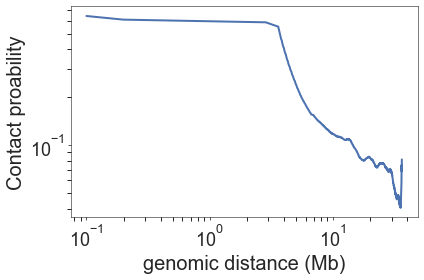

In [48]:
pofs = obs_over_exp(contact_map_combined)
fig, ax = plt.subplots()
N = len(contact_map_combined)
sdistances = np.cumsum(np.diff(data_combined['mid_position_Mb']))
ax.plot(sdistances, pofs[1:])
format_ticks(ax, y=False, rotate=False)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('genomic distance (Mb)')
ax.set_ylabel('Contact proability')
fig.tight_layout()
plt.savefig('../../plots/contact_prob_scaling_chr21.pdf')

<IPython.core.display.Javascript object>


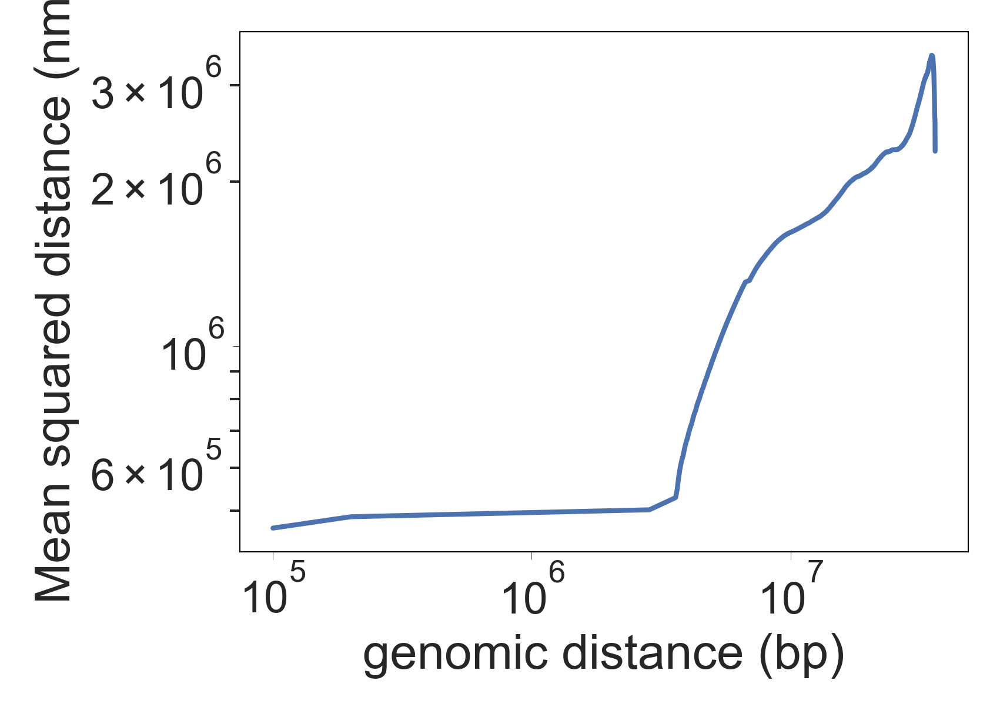

In [147]:
expected = obs_over_exp(msd_map_combined)
fig, ax = plt.subplots()
sdistances = np.cumsum(np.diff(data_combined['mid_position_Mb'])) * 10**6
ax.plot(sdistances, expected[1:])
#format_ticks(ax, y=False, rotate=False)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('genomic distance (bp)')
ax.set_ylabel('Mean squared distance (nm)')
fig.tight_layout()
plt.savefig('../../plots/mean_squared_distance_chr21.pdf')

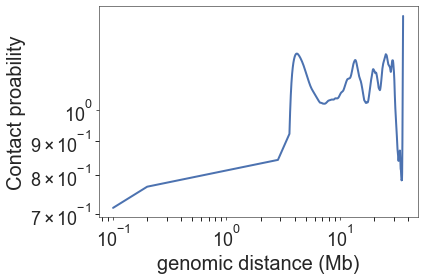

In [47]:
pofs = obs_over_exp(gaussian_filter(contact_normed_map, contact_gaussian_sigma))
fig, ax = plt.subplots()
N = len(contact_map_combined)
sdistances = np.cumsum(np.diff(data_combined['mid_position_Mb']))
ax.plot(sdistances, pofs[1:])
format_ticks(ax, y=False, rotate=False)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('genomic distance (Mb)')
ax.set_ylabel('Contact proability')
fig.tight_layout()
plt.savefig('../../plots/contact_prob_scaling_chr21.pdf')

<a id='2.2'></a>
## 2.2 load corresponding Hi-C map 

from: *Rao et al., 2014* 

A cleaned version of contact matrix for corresponding genomic regions is saved into the provided dataset as well.

In [15]:
# load Hi-C
hic_filename = Path('../../data/Hi-C_contacts_chromosome21.tsv')

hic_raw_map = []

with open(hic_filename, 'r') as _handle:
    _reader = csv.reader(_handle, delimiter='\t', quotechar='|')
    col_regions = next(_reader)[1:]
    row_regions = []
    # loop through content
    for _contents in _reader:
        row_regions.append(_contents[0])
        hic_raw_map.append([float(_c) for _c in _contents[1:]])
hic_raw_map = np.array(hic_raw_map)
# sort row and col to match tsv dataset
row_order = np.concatenate([np.where(data_rep1['region_names']==_rn)[0] for _rn in row_regions])
col_order = np.concatenate([np.where(data_rep1['region_names']==_cn)[0] for _cn in col_regions])
hic_raw_map = hic_raw_map[row_order][:, col_order]

<a id='2.3'></a>
## 2.3 call compartments

1. remove genomic effect by log-log linear regression between contact/hic map with genomic distance map and normalize with it
2. calculate correlation map
3. do PCA, use PC1 as AB calling
4. merge very small compartment fragments for calling robustness

(FigS2A, Fig2A)

<a id='2.3.1'></a>
### 2.3.1 calculate and plot PC1

(FigS2A)

In [16]:
%matplotlib inline

In [17]:
from scipy.stats import linregress
## compartment calling by PCA

#for contact_gaussian_sigma in np.arange(0,3,0.03):
# Generate correlation map
contact_gaussian_sigma = 1.9
hic_gaussian_sigma = 1.9
# normalize genomic distance effects
genomic_distance_map = squareform(pdist(data_combined['mid_position_Mb'][:,np.newaxis]))
genomic_distance_entries = genomic_distance_map[np.triu_indices(len(genomic_distance_map),1)]

# normalize genomic distance effects
contact_entries = contact_map_combined[np.triu_indices(len(contact_map_combined
                                                      ),1)]
kept = (genomic_distance_entries > 0) * (contact_entries > 0)
contact_lr = linregress(np.log(genomic_distance_entries[kept]), np.log(contact_entries[kept]))

NameError: name 'contact_map_combined' is not defined

<IPython.core.display.Javascript object>


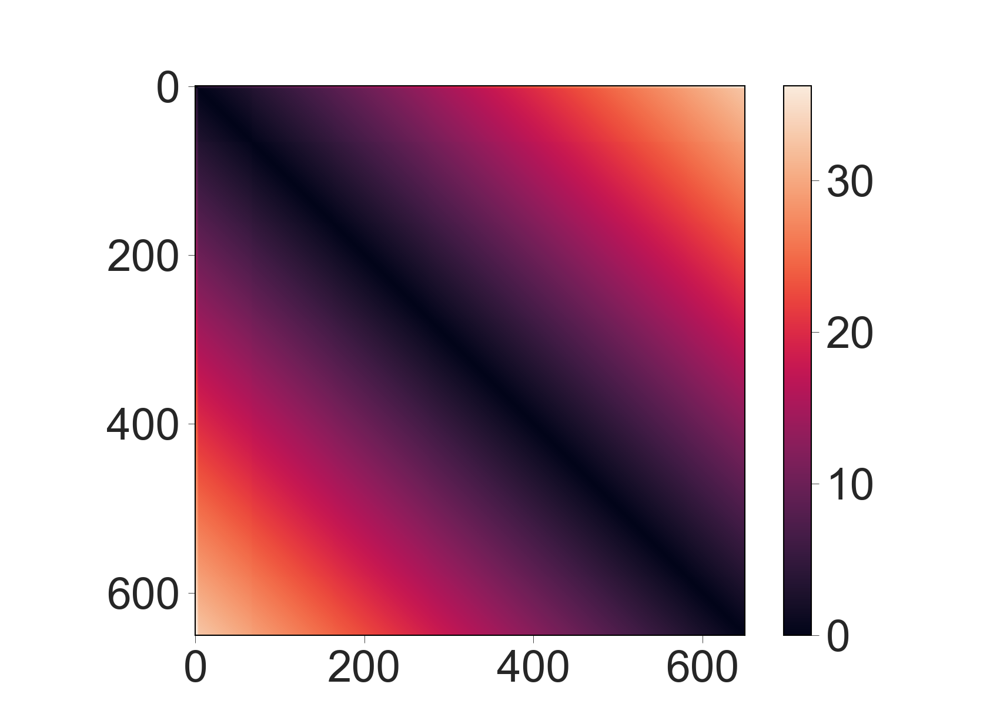

In [87]:
im = plt.imshow(genomic_distance_map)
plt.colorbar(im)

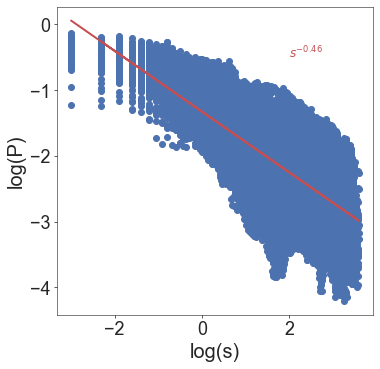

In [115]:
import plot_functions
fig, ax = plt.subplots(figsize = (half_slide_width, half_slide_width))
logs = np.log(genomic_distance_entries[kept])
ax.scatter(logs, np.log(contact_entries[kept]))
ax.plot(logs, logs*contact_lr.slope + contact_lr.intercept, 'r-')
ax.set_xlabel('log(s)')
ax.set_ylabel('log(P)')
ax.text(2.0, -0.5, r'$s^{-0.46}$', color='r')
plt.savefig('../../plots/Chr21_figures/contact_scaling_regression_chr21.pdf')

In [146]:
contact_gaussian_sigma

1.9

In [145]:
contact_lr.slope

-0.4622773849709115

In [237]:
hic_lr.slope

-0.9585659791627527

In [42]:
#print(contact_lr)
contact_norm_map = np.exp(np.log(genomic_distance_map) * contact_lr.slope + contact_lr.intercept)
#for _i in range(len(normalization_mat)):
#    contact_norm_map[_i,_i] = 1
contact_normed_map = contact_map_combined / contact_norm_map
# apply gaussian
from scipy.ndimage import gaussian_filter

contact_corr_map_combined = np.corrcoef(gaussian_filter(contact_normed_map, contact_gaussian_sigma))

# normalize genomic distance effects
hic_entries = hic_raw_map[np.triu_indices(len(hic_raw_map),1)]
kept = (genomic_distance_entries > 0) * (hic_entries > 0)
hic_lr = linregress(np.log(genomic_distance_entries[kept]), np.log(hic_entries[kept]))
#print(hic_lr)
hic_norm_map = np.exp(np.log(genomic_distance_map) * hic_lr.slope + hic_lr.intercept)
#for _i in range(len(normalization_mat)):
#    hic_norm_map[_i,_i] = 1
hic_normed_map = hic_raw_map / hic_norm_map
# apply gaussian
from scipy.ndimage import gaussian_filter

hic_corr_map = np.corrcoef(gaussian_filter(hic_normed_map, hic_gaussian_sigma))

# Do PCA
from sklearn.decomposition import PCA
contact_model = PCA(1)
contact_model.fit(contact_corr_map_combined)
contact_pc1_combined = np.reshape(contact_model.fit_transform(contact_corr_map_combined), -1)

hic_model = PCA(1)
hic_model.fit(hic_corr_map)
hic_pc1 = np.reshape(hic_model.fit_transform(hic_corr_map), -1)


/tmp/ipykernel_11492/1271275119.py:2: RuntimeWarning: divide by zero encountered in log
  contact_norm_map = np.exp(np.log(genomic_distance_map) * contact_lr.slope + contact_lr.intercept)
/tmp/ipykernel_11492/1271275119.py:16: RuntimeWarning: divide by zero encountered in log
  hic_norm_map = np.exp(np.log(genomic_distance_map) * hic_lr.slope + hic_lr.intercept)


In [231]:
len(np.arange(0, 651))

651

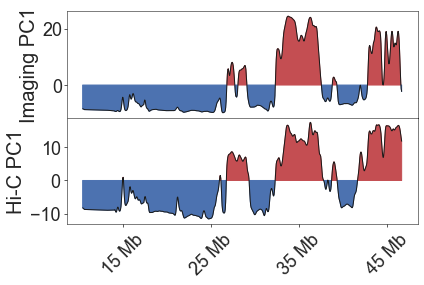

In [109]:
## pc1 barplot
fig, ax = plt.subplots()
grid = plt.GridSpec(2, 1, height_ratios=[1,1], hspace=0., wspace=0.)
contact_ax = plt.subplot(grid[0])
loci_range = data_combined['mid_position_Mb'] * 10**6
contact_ax.plot(loci_range, contact_pc1_combined, 'k', lw=1.0)
contact_ax.fill_between(loci_range, 0, contact_pc1_combined, where=contact_pc1_combined >= 0,
                       color='r')
contact_ax.fill_between(loci_range, 0, contact_pc1_combined, where=contact_pc1_combined < 0,
                       color='b')
contact_ax.tick_params('both', 
            pad=1,labelbottom=False)
contact_ax.set_ylabel('Imaging PC1')
contact_ax.set_xticks([15*10**6, 25*10**6, 35*10**6, 45*10**6])
# hic-ax
hic_ax = plt.subplot(grid[1], sharex=contact_ax)
hic_ax.plot(loci_range, hic_pc1, 'k', lw=1.0)
hic_ax.fill_between(loci_range, 0, hic_pc1, where=hic_pc1 >= 0, color='r')
hic_ax.fill_between(loci_range, 0, hic_pc1, where=hic_pc1 < 0, color='b')
hic_ax.set_ylabel('Hi-C PC1')
hic_ax.set_xticks([15*10**6, 25*10**6, 35*10**6, 45*10**6])
format_ticks(hic_ax, y=False)
fig.tight_layout()
plt.savefig(os.path.join(figure_folder, f'chr21_pc1_combined.pdf'), transparent=True)

<a id='2.3.2'></a>
### 2.3.2 further merge small domains and save compartments

In [44]:
# define AB compartment by merging small sub-compartments
min_comp_size = 7 # allowed minimum sub-compartment size

temp_AB_dict = {'A':np.where(contact_pc1_combined >= 0)[0],
                'B':np.where(contact_pc1_combined < 0)[0],}

temp_AB_vector = np.ones(len(zxys_combined_list[0])).astype(np.int) * -1
temp_AB_vector[temp_AB_dict['A']] = 1
temp_AB_vector[temp_AB_dict['B']] = 0

num_small_compartment = np.inf
prev_v = temp_AB_vector[0]
while num_small_compartment > 0:
    # find indices for all sub-comaprtments
    all_comp_inds = []
    _comp_inds = []
    prev_v = temp_AB_vector[0] # initialize previous compartment
    for _i, _v in enumerate(temp_AB_vector):
        if prev_v != _v:
            all_comp_inds.append(_comp_inds)
            _comp_inds = [_i]
        else:
            _comp_inds.append(_i)            
        prev_v = _v
    if _comp_inds != []:
        all_comp_inds.append(_comp_inds)
    # calculate length of each compartment
    all_comp_lens = np.array([len(_c) for _c in all_comp_inds])
    # update number of small comparment
    num_small_compartment = np.sum(all_comp_lens < min_comp_size)
    # choose the smallest compartment to flip its AB
    if num_small_compartment > 0:
        print(all_comp_lens, num_small_compartment)
        flip_ind = np.argmin(all_comp_lens)
        temp_AB_vector[np.array(all_comp_inds[flip_ind])] = 1 - temp_AB_vector[np.array(all_comp_inds[flip_ind])]

# based on this cleaned AB_vector, recreate AB_dict
data_combined['AB_dict'] = {
    'A': np.where(temp_AB_vector==1)[0],
    'B': np.where(temp_AB_vector==0)[0],
}

[255  18   6  21  64 105  25  10  70  75   2] 2
[255  18   6  21  64 105  25  10  70  77] 1


/tmp/ipykernel_11492/3027678692.py:7: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  temp_AB_vector = np.ones(len(zxys_combined_list[0])).astype(np.int) * -1


In [45]:
pickle.dump(data_combined['AB_dict'], 
            open(os.path.join(data_folder, f'chr21_combined_AB_dict_{contact_gaussian_sigma}.pkl'), 'wb'))

In [ ]:
chr21_ABdict = pickle.load(open(os.path.join(data_folder, f'chr2_rep1_AB_dict_0.5.pkl'), 'rb'))

In [11]:
chr21_ABdict = data_combined['AB_dict']
loci_inds = np.zeros((651,))
loci_inds[chr21_ABdict['A']] = 1.0
np.save('/net/levsha/share/deepti/data/ABidentities_chr21_Su2020.npy', loci_inds)
np.save('/net/levsha/share/deepti/data/ABidentities_chr21_Su2020_2perlocus.npy', np.repeat(loci_inds, 2))
np.save('/net/levsha/share/deepti/data/ABidentities_chr21_Su2020_10perlocus.npy', np.repeat(loci_inds, 10))

<a id='2.3.3'></a>
### 2.3.3 plot correlation map with AB calling

(Fig2A)

/tmp/ipykernel_11492/2658479349.py:16: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("seismic").copy()
  current_cmap.set_bad(color=[0.5,0.5,0.5,1])


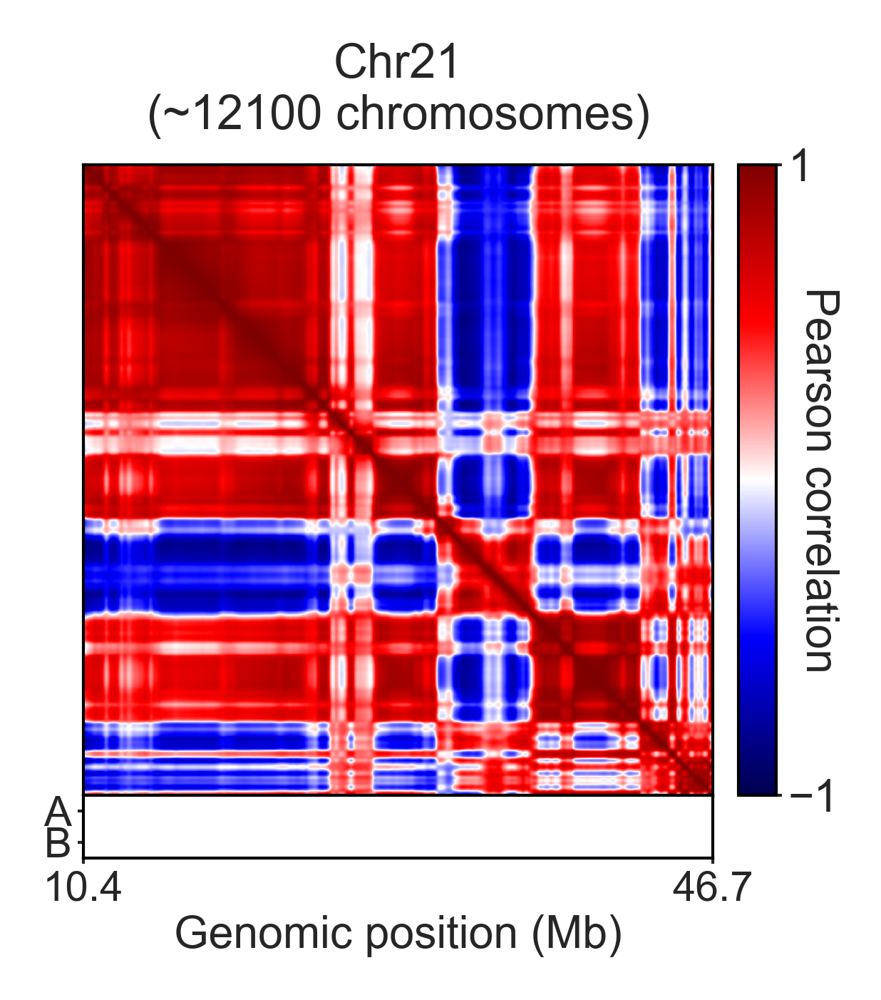

In [46]:
lims = [0,len(contact_corr_map_combined)]

xlims = np.array([min(lims), max(lims)])
ylims = np.array([min(lims), max(lims)])

from mpl_toolkits.axes_grid1 import make_axes_locatable

domain_line_color = [1,1,0,1]
domain_line_width = 1.5
bad_color=[0,0,0,1]

fig, ax1 = plt.subplots(figsize=(_single_col_width, _single_col_width), dpi=600)

# create a color map
current_cmap = matplotlib.cm.get_cmap('seismic')
current_cmap.set_bad(color=[0.5,0.5,0.5,1])

_pf = ax1.imshow(contact_corr_map_combined, cmap=current_cmap, vmin=-1, vmax=1)

ax1.tick_params('both', labelsize=_font_size, 
                width=_ticklabel_width, length=0,
                pad=1, labelleft=False, labelbottom=False) # remove bottom ticklabels for ax1
[i[1].set_linewidth(_ticklabel_width) for i in ax1.spines.items()]


# locate ax1
divider = make_axes_locatable(ax1)

# colorbar ax
cax = divider.append_axes('right', size='6%', pad="4%")
cbar = plt.colorbar(_pf,cax=cax, ax=ax1, ticks=[-1,1])
cbar.ax.tick_params('both', labelsize=_font_size, 
                width=_ticklabel_width, length=_ticklabel_size-1,
                pad=1, labelleft=False) # remove bottom ticklabels for ax1
cbar.outline.set_linewidth(_ticklabel_width)
cbar.set_label('Pearson correlation', 
               fontsize=_font_size, labelpad=0, rotation=270)

# create bottom ax
bot_ax = divider.append_axes('bottom', size='10%', pad="0%", 
                             sharex=ax1, xticks=[])
bot_ax.bar(data_combined['AB_dict']['A'], height=1, color='r', width=1, label='A')
bot_ax.bar(data_combined['AB_dict']['B'], height=-1, color='b', width=1, label='B')
bot_ax.set_yticks([])
bot_ax.set_yticklabels([])
bot_ax.set_ylim([-1,1])
bot_ax.set_yticks([0.5,-0.5])
bot_ax.set_yticklabels(["A","B"])

_xticks = [-0.5, len(contact_corr_map_combined)-0.5]
_xticklabels =  [data_combined['start_position_Mb'][0],
                 data_combined['end_position_Mb'][-1],] 

bot_ax.set_xticks(_xticks)
bot_ax.set_xticklabels(_xticklabels)
# tick params
bot_ax.tick_params('both', labelsize=_font_size-0.5, 
                width=_ticklabel_width, length=_ticklabel_size-1,
                pad=1, labelleft=True, labelbottom=True) # remove bottom ticklabels for ax1
[i[1].set_linewidth(_ticklabel_width) for i in bot_ax.spines.items()]
# set labels
bot_ax.set_xlabel(f'Genomic position (Mb)', fontsize=_font_size, labelpad=1)

# set limits
bot_ax.set_xlim(xlims-0.5)

ax1.set_title(f"Chr21\n(~{np.round(len(data_combined['chrom_ids']),-2)} chromosomes)", fontsize=_font_size+0.5)

# save
plt.gcf().subplots_adjust(bottom=0.15, left=0.16, right=0.88)

#plt.savefig(os.path.join(figure_folder, f'Fig2A_chr21_contact_corr_map_combined.pdf'), transparent=True)

plt.show()

<a id='3'></a>
# 3. Analysis of A/B density in single-cells

<a id='3.1'></a>
## 3.1 calculate density scores

by placing gaussian pdf at the coordinates of genomic regions

In [145]:
data_combined['dna_zxys'].shape

(12149, 651, 3)

In [77]:
import multiprocessing as mp
import time
num_threads=32
density_var = 108 # nm
overwrite=True

# density score for 50kb genomic regions
_dna_density_args = [(_zxys,_zxys, data_combined['AB_dict'], [density_var,density_var,density_var], True) 
                     for _zxys in data_combined['dna_zxys']]
_dna_density_time = time.time()

print(f"Multiprocessing calculate dna_density_scores", end=' ')
if 'dna_density_scores' not in data_combined or overwrite:
    with mp.Pool(num_threads) as dna_density_pool:
        dna_density_dicts = dna_density_pool.starmap(ia.compartment_tools.scoring.spot_density_scores, _dna_density_args)
        dna_density_pool.close()
        dna_density_pool.join()
        dna_density_pool.terminate()
    # save
    data_combined['dna_density_scores'] = dna_density_dicts
print(f"in {time.time()-_dna_density_time:.3f}s.")

# density score for tss
_gene_density_args = [(_gzxys,_zxys, data_combined['AB_dict'], [density_var,density_var,density_var], True) 
                     for _gzxys, _zxys in zip(data_combined['tss_zxys'], data_combined['dna_zxys']) ]
_gene_density_time = time.time()

print(f"Multiprocessing calculate gene_density_scores", end=' ')
if 'gene_density_scores' not in data_combined or overwrite:
    with mp.Pool(num_threads) as gene_density_pool:
        gene_density_dicts = gene_density_pool.starmap(ia.compartment_tools.scoring.spot_density_scores, _gene_density_args)
        gene_density_pool.close()
        gene_density_pool.join()
        gene_density_pool.terminate()
    # save
    data_combined['gene_density_scores'] = gene_density_dicts
print(f"in {time.time()-_gene_density_time:.3f}s.")

Multiprocessing calculate dna_density_scores in 101.670s.
Multiprocessing calculate gene_density_scores in 19.861s.


<a id='3.2'></a>
## 3.2 median density for chr21

medians are taken across chromosome copies

(FigS2C)

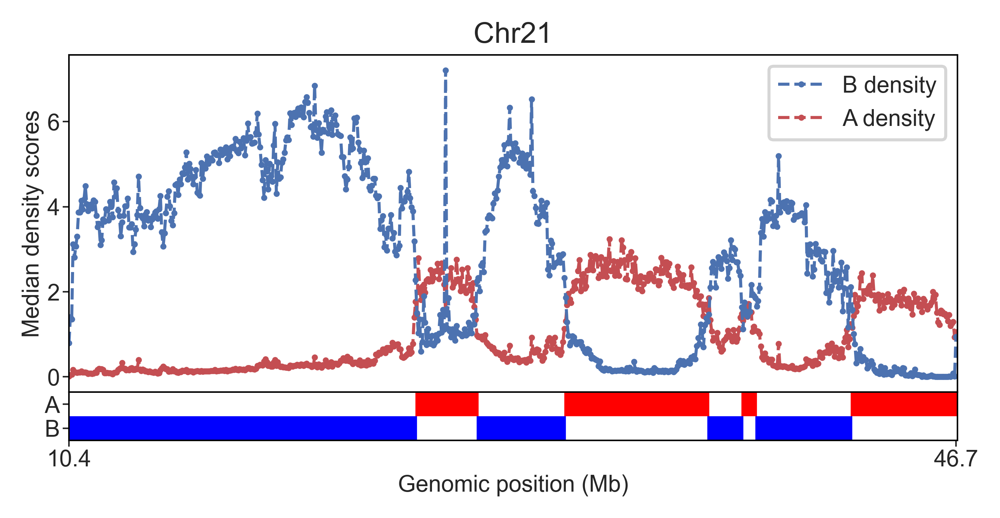

In [78]:
# Calculate mean A, B density
mean_A_scores = np.nanmedian([_s['A'] for _s in data_combined['dna_density_scores']], axis=0)
mean_B_scores = np.nanmedian([_s['B'] for _s in data_combined['dna_density_scores']], axis=0)

# Plot
fig = plt.figure(figsize=(_double_col_width, _single_col_width),dpi=600)
grid = plt.GridSpec(2, 1, height_ratios=[7,1], hspace=0., wspace=0.2)

main_ax = plt.subplot(grid[0], xticklabels=[])

main_ax.plot(mean_A_scores, 'r.--', label='A density', markersize=2, linewidth=1)
main_ax.plot(mean_B_scores, 'b.--', label='B density', markersize=2, linewidth=1)

# ticks
main_ax.tick_params('both', labelsize=_font_size, 
                width=_ticklabel_width, length=_ticklabel_size,
                pad=1, labelbottom=False) # remove bottom ticklabels for ax1
main_ax.tick_params('x', length=0)
[i[1].set_linewidth(_ticklabel_width) for i in main_ax.spines.items()]
main_ax.set_ylabel(f"Median density scores", fontsize=_font_size, labelpad=1)

handles, labels = main_ax.get_legend_handles_labels()
main_ax.legend(handles[::-1], labels[::-1], fontsize=_font_size, loc='upper right')
main_ax.set_xlim(0,len(mean_A_scores))
main_ax.set_title('Chr21', fontsize=_font_size+2, pad=4)

comp_ax = plt.subplot(grid[1], xticklabels=[], sharex=main_ax)
comp_ax.eventplot([data_combined['AB_dict']['A'], data_combined['AB_dict']['B']], lineoffsets=[0.5,-0.5],linelengths=1, linewidths=1, 
                   colors=np.array([[1, 0, 0],[0, 0, 1]]))
#comp_ax.imshow(comp_vector[np.newaxis,:], cmap='seismic', vmin=-1, vmax=1)
comp_ax.tick_params('both', labelsize=_font_size, 
                    width=_ticklabel_width, length=_ticklabel_size,
                    pad=1, labelbottom=True) # remove bottom ticklabels for ax1
[i[1].set_linewidth(_ticklabel_width) for i in comp_ax.spines.items()]

comp_ax.set_yticks([0.5,-0.5])
comp_ax.set_yticklabels(["A","B"])
comp_ax.set_ylim([-1,1])
_xticks = [0, len(mean_A_scores)-1]
comp_ax.set_xticks(_xticks)
comp_ax.set_xticklabels(np.round(mid_positions_Mb[_xticks], 1))
comp_ax.set_xlabel(f'Genomic position (Mb)', fontsize=_font_size, labelpad=1)



plt.gcf().subplots_adjust(bottom=0.1, left=0.05)

plt.savefig(os.path.join(figure_folder, 'FigS2C_chr21_mean_AB_density_combined.pdf'), transparent=True)

plt.show()

<a id='3.3'></a>
## 3.3 visualize density in the example chromosome 

(FigS2B)

1058


E:\Users\puzheng\anaconda3\lib\site-packages\ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in less
E:\Users\puzheng\anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: invalid value encountered in greater
E:\Users\puzheng\anaconda3\lib\site-packages\matplotlib\colors.py:512: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


-- add colorbar with colornorm: <matplotlib.colors.Normalize object at 0x0000024410031780>
-- save 3d-rendering into file:E:\Users\puzheng\Documents\2020_cell_figures\Chr21_compartment_figures\FigS2B1_3d_render_chr-1058_combined_AB-calling.pdf


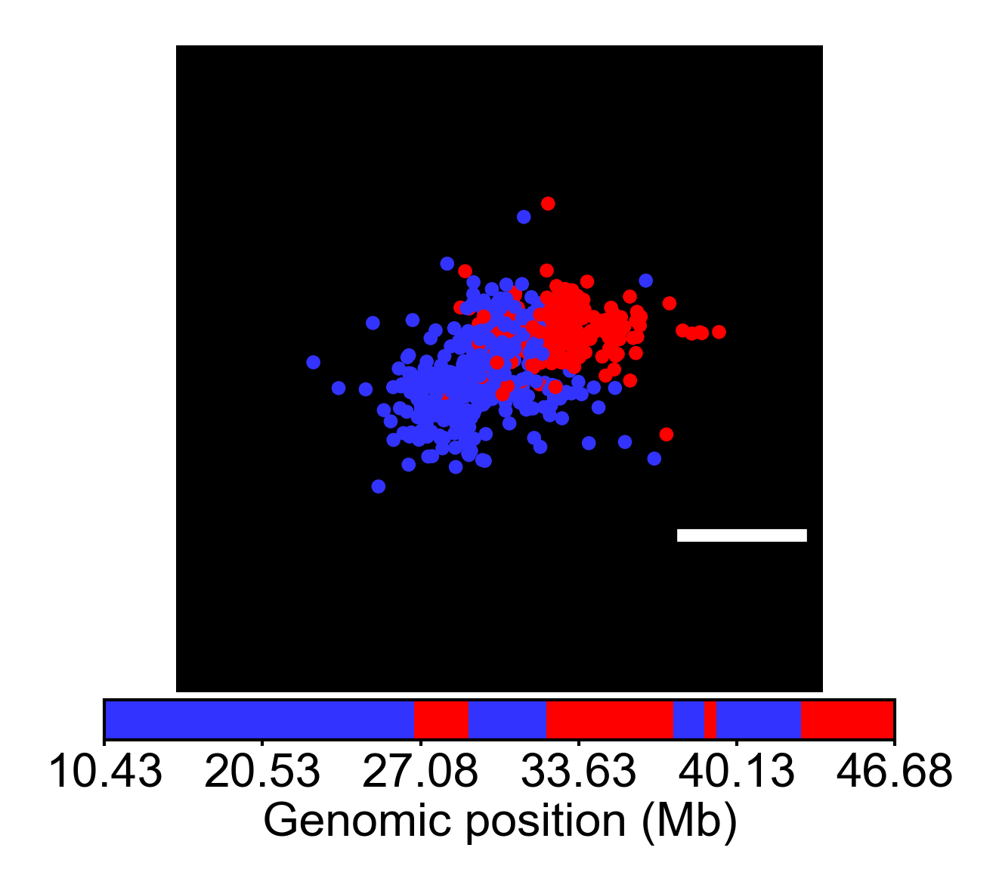

-- add colorbar with colornorm: <matplotlib.colors.Normalize object at 0x0000024411D5BB00>
-- save 3d-rendering into file:E:\Users\puzheng\Documents\2020_cell_figures\Chr21_compartment_figures\FigS2B2_3d_render_chr-1058_combined_AB-ratio.pdf


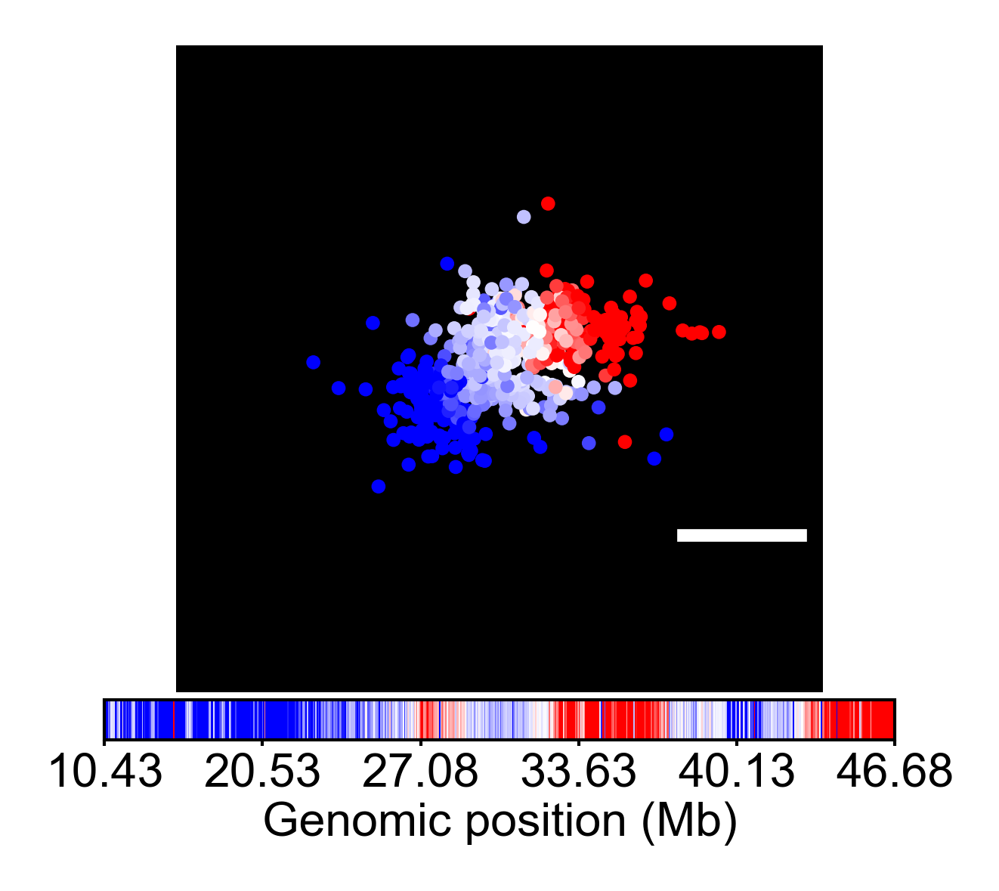

In [17]:
## prepare examples

# example chromosome id
example_id = 1058
#for example_id in np.arange(1037,1057):
dna_zxys = data_combined['dna_zxys'][example_id]
print(example_id)

# prepare AB score and log(A/B) ratio
ascores = data_combined['dna_density_scores'][example_id]['A']
bscores = data_combined['dna_density_scores'][example_id]['B']
abratios = np.log(ascores / bscores) - np.log(len(data_combined['AB_dict']['A'])/len(data_combined['AB_dict']['B']))
abratios = abratios / np.log(2)
def normalize_color(mat, vmin=None, vmax=None):
    _mat = np.array(mat).copy()
    if vmin is None:
        vmin = np.nanmin(_mat)
    if vmax is None:
        vmax = np.nanmax(_mat)
    # based on vmin vmax, do thresholding
    _mat[_mat < vmin] = vmin
    _mat[_mat > vmax] = vmax
    _mat = (_mat - np.nanmin(_mat)) / (np.nanmax(_mat) - np.nanmin(_mat))
    return _mat

## prepare colors
# compartment color cmap
comp_colors = []
for _i in np.arange(len(dna_zxys)):
    if _i in data_combined['AB_dict']['A']:
        comp_colors.append([1,0,0,1])
    elif _i in data_combined['AB_dict']['B']:
        comp_colors.append([0.2,0.2,1,1])
    else:
        raise ValueError
from matplotlib.colors import ListedColormap
comp_cmap = ListedColormap(comp_colors)

# ratio color map
ratio_cmap = matplotlib.cm.get_cmap('bwr')
color_limits = [-15, 15]
ratio_colors = np.array([np.array(ratio_cmap(_s)) 
                         for _s in normalize_color(abratios, 
                                                   vmin=min(color_limits),
                                                   vmax=max(color_limits))])
# plot AB calling
from source.figure_tools.image import chromosome_structure_3d_rendering
ax3d, cb = chromosome_structure_3d_rendering(dna_zxys, 
                                             cmap=comp_cmap, 
                                             image_radius=500,
                                             pca_align=False,
                                             marker_size=5, line_width=0.,
                                             marker_alpha=1, line_alpha=1,
                                             #view_azim_angle=180, view_elev_angle=90,
                                             cbar_tick_labels=data_combined['mid_position_Mb'],
                                             cbar_label='Genomic position (Mb)',
                                             cbar_shrink=1,
                                             save=True, save_folder=figure_folder, 
                                             save_basename=f'FigS2B1_3d_render_chr-{example_id}_combined_AB-calling.pdf')
plt.show()

# plot ratio
ax3d, cb = chromosome_structure_3d_rendering(dna_zxys, 
                                             cmap=ratio_colors, 
                                             image_radius=500,
                                             pca_align=False,
                                             marker_size=5, line_width=0.,
                                             marker_alpha=1, line_alpha=1,
                                             #view_azim_angle=180, view_elev_angle=90,
                                             cbar_tick_labels=data_combined['mid_position_Mb'],
                                             cbar_label='Genomic position (Mb)',
                                             cbar_shrink=1,
                                             save=True, save_folder=figure_folder, 
                                             save_basename=f'FigS2B2_3d_render_chr-{example_id}_combined_AB-ratio.pdf')
plt.show()


<a id='3.4'></a>
## 3.4 calculate segregation scores based on A,B density

(Fig2C)

In [79]:
def randomize_AB_dict(AB_dict):
    all_regs = np.sort(np.concatenate(list(AB_dict.values())))
    AB_identities = np.zeros(len(all_regs))
    AB_identities[np.array([_i for _i,_r in enumerate(all_regs) 
                            if _r in AB_dict['A']])] = 1
    # randomize new start
    new_start = np.random.randint(0, len(all_regs))
    new_AB_identities = np.concatenate([AB_identities[new_start:], AB_identities[:new_start]])
    # recreate AB_dict
    new_AB_dict = {'A': np.sort(all_regs[np.where(new_AB_identities==1)[0]]),
                   'B': np.sort(all_regs[np.where(new_AB_identities==0)[0]]),}
    return new_AB_dict

# calculate dynamic fraction scores
from scipy.stats import scoreatpercentile

In [108]:
print(f'Number of A loci: {np.sum(AB_identities_combined)}')
_sd = data_combined['dna_density_scores'][0]
print(f'Threshold score corresponding to 33rd percentile of A loci A density scores: {A_ths[0]}')
print(f"Number of A loci above threshold: {np.sum(_sd['A'][data_combined['AB_dict']['A']] >= A_ths[0])}")
print(f"Number of B loci above threshold: {np.sum(_sd['A'][data_combined['AB_dict']['B']] >= A_ths[0])}")
print(f"Purity score: {np.nanmean(AB_identities_combined[np.where(_sd['A'] >= A_ths[0])[0]])}")
np.mean(AB_identities_combined[np.where(_sd['A'] >= A_ths[0])[0]])

Number of A loci: 237.0
Threshold score corresponding to 33rd percentile of A loci A density scores: 1.91618104106716
Number of A loci above threshold: 152
Number of B loci above threshold: 86
Purity score: 0.6386554621848739


0.6386554621848739

In [80]:
AB_identities_combined = np.ones(len(data_combined['dna_zxys'][0])) * np.nan
AB_identities_combined[data_combined['AB_dict']['A']] = 1
AB_identities_combined[data_combined['AB_dict']['B']] = 0

# calculate re-thresholded fraction scores
A_fracs, B_fracs = [], []
A_ths, B_ths = [], []
cloud_th_per=67
for _sd in tqdm(data_combined['dna_density_scores']):
    # define A,B threshold based on their own densities
    _A_th = scoreatpercentile(_sd['A'][data_combined['AB_dict']['A']], 100-cloud_th_per)
    _B_th = scoreatpercentile(_sd['B'][data_combined['AB_dict']['B']], 100-cloud_th_per)
    # calculate purity within A,B clouds
    A_fracs.append(np.nanmean(AB_identities_combined[np.where(_sd['A'] >= _A_th)[0]]))
    B_fracs.append(1-np.nanmean(AB_identities_combined[np.where(_sd['B'] >= _B_th)[0]]))
    # store AB thresholds for references
    A_ths.append(_A_th)
    B_ths.append(_B_th)
# calculate re-thresholded fraction scores
rand_A_fracs, rand_B_fracs = [], []

for _sd in tqdm(data_combined['dna_density_scores']):
    # randomize AB dict
    _rand_AB_dict = randomize_AB_dict(data_combined['AB_dict'])
    _rand_A_inds, _rand_B_inds = np.array(_rand_AB_dict['A']), np.array(_rand_AB_dict['B'])
    # generate randomized AB_identities_combined vector for purity calculation
    _rand_AB_identities_combined = np.ones(len(data_combined['dna_zxys'][0])) * np.nan
    _rand_AB_identities_combined[_rand_AB_dict['A']] = 1
    _rand_AB_identities_combined[_rand_AB_dict['B']] = 0
    # define A,B threshold based on their own densities
    _A_th = scoreatpercentile(_sd['A'][_rand_A_inds], 100-cloud_th_per)
    _B_th = scoreatpercentile(_sd['B'][_rand_B_inds], 100-cloud_th_per)
    # calculate purity within A,B clouds
    rand_A_fracs.append(np.nanmean(_rand_AB_identities_combined[np.where(_sd['A'] >= _A_th)[0]]))
    rand_B_fracs.append(1-np.nanmean(_rand_AB_identities_combined[np.where(_sd['B'] >= _B_th)[0]]))

# Save
data_combined['segregation_scores'] = (np.array(A_fracs) + np.array(B_fracs)) / 2
data_combined['randomized_segregation_scores'] = (np.array(rand_A_fracs) + np.array(rand_B_fracs)) / 2

  0%|          | 0/12149 [00:00<?, ?it/s]

/tmp/ipykernel_11492/2781124163.py:15: RuntimeWarning: Mean of empty slice
  B_fracs.append(1-np.nanmean(AB_identities_combined[np.where(_sd['B'] >= _B_th)[0]]))
/tmp/ipykernel_11492/2781124163.py:14: RuntimeWarning: Mean of empty slice
  A_fracs.append(np.nanmean(AB_identities_combined[np.where(_sd['A'] >= _A_th)[0]]))


  0%|          | 0/12149 [00:00<?, ?it/s]

/tmp/ipykernel_11492/2781124163.py:35: RuntimeWarning: Mean of empty slice
  rand_B_fracs.append(1-np.nanmean(_rand_AB_identities_combined[np.where(_sd['B'] >= _B_th)[0]]))
/tmp/ipykernel_11492/2781124163.py:34: RuntimeWarning: Mean of empty slice
  rand_A_fracs.append(np.nanmean(_rand_AB_identities_combined[np.where(_sd['A'] >= _A_th)[0]]))


In [84]:
len(A_fracs)

12149

### segregation score histogram for Chr21

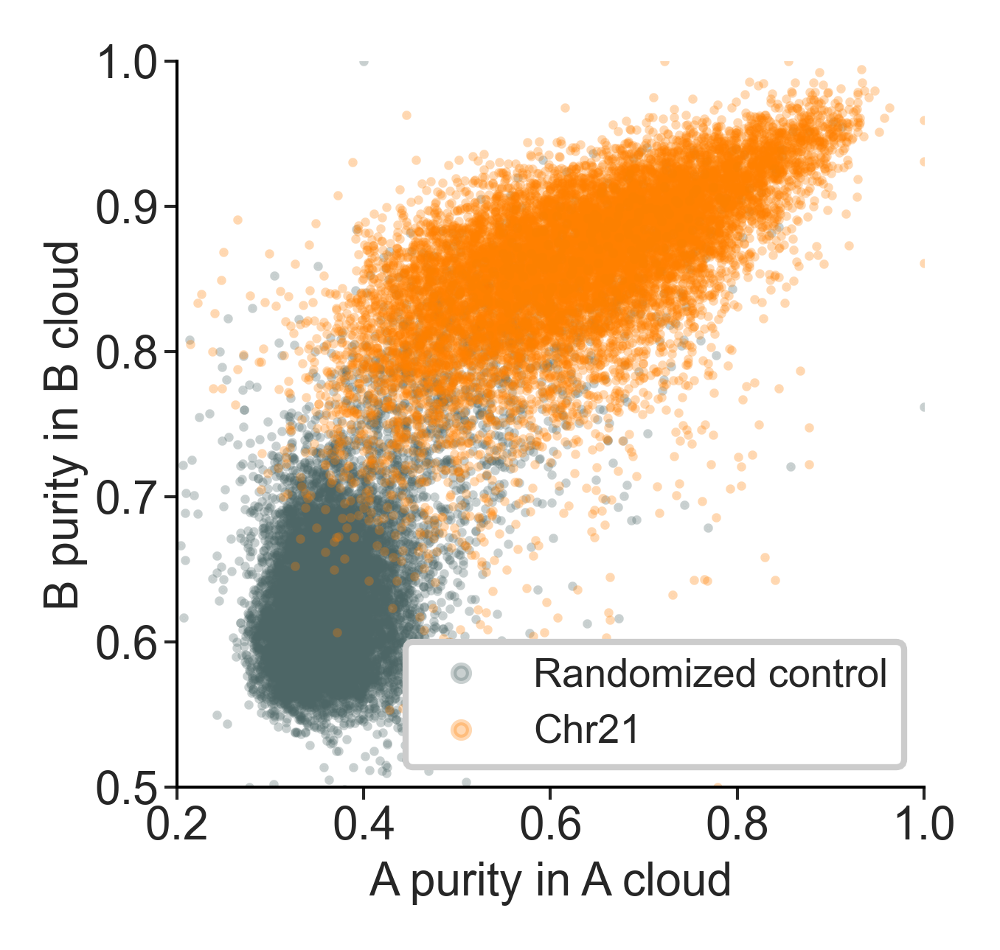

In [81]:
fig, ax = plt.subplots(figsize=(_single_col_width, _single_col_width),dpi=600)

ax.plot(rand_A_fracs, rand_B_fracs, '.', label='Randomized control', 
        color=[0.3,0.4,0.4], alpha=0.3, markersize=1 )
ax.plot(A_fracs, B_fracs, '.', label='Chr21', 
        color=[1,0.5,0],alpha=0.3, markersize=1 )

plt.legend(fontsize=_font_size-1, loc='lower right', framealpha=1, markerscale=5,)

ax.tick_params('both', labelsize=_font_size, 
               width=_ticklabel_width, length=_ticklabel_size,
               pad=1, 
               #labelleft=False, labelbottom=False
               ) # remove bottom ticklabels for ax1
[i[1].set_linewidth(_ticklabel_width) for i in ax.spines.items()]
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

ax.set_xlim([0.2, 1])
ax.set_ylim([0.5, 1])
ax.set_xlabel(f'A purity in A cloud', fontsize=_font_size, labelpad=2)
ax.set_ylabel(f'B purity in B cloud', fontsize=_font_size, labelpad=1)

plt.gcf().subplots_adjust(bottom=0.15, left=0.15)

plt.savefig(os.path.join(figure_folder, f'chr21_fraction_score_scatter_th{cloud_th_per}.pdf'), transparent=True)

plt.show()

E:\Users\puzheng\anaconda3\lib\site-packages\numpy\lib\histograms.py:824: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
E:\Users\puzheng\anaconda3\lib\site-packages\numpy\lib\histograms.py:825: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


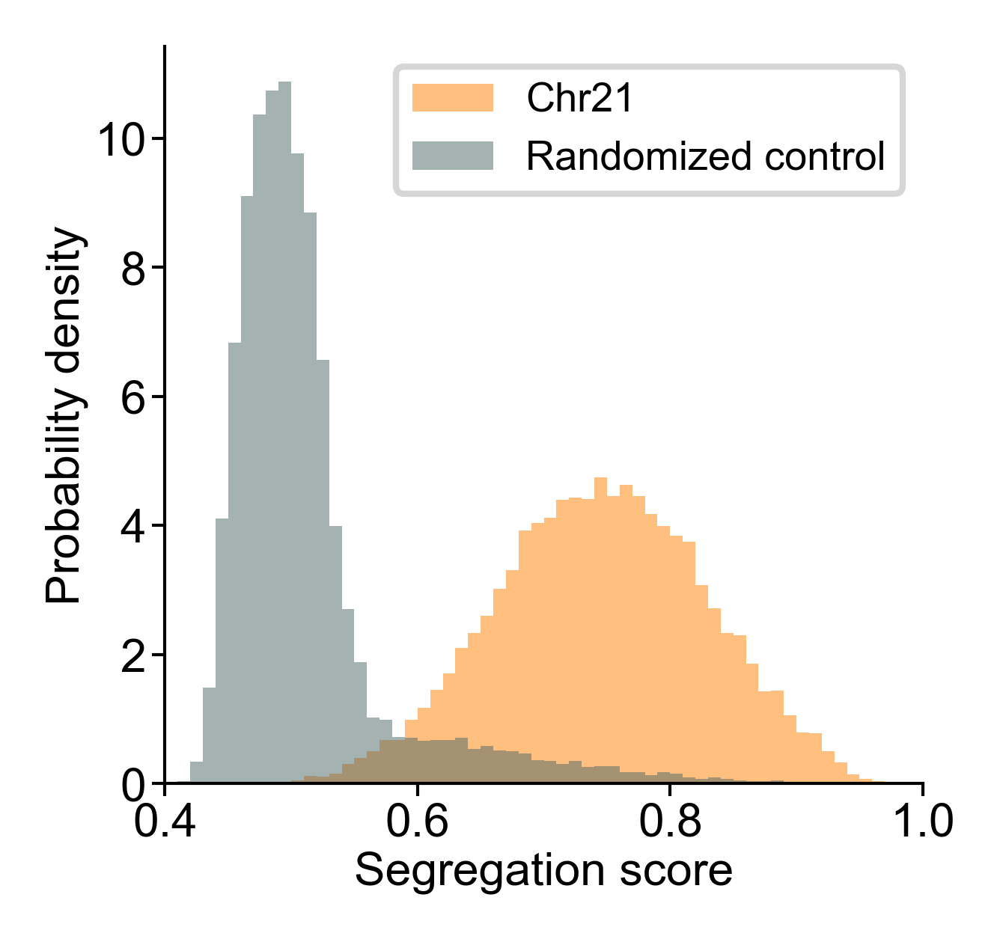

In [115]:
%matplotlib inline
fig, ax = plt.subplots(figsize=(_single_col_width, _single_col_width),dpi=600)
ax.hist(data_combined['segregation_scores'], 100, range=(0.,1), 
        density=True, alpha=0.5, 
        color=[1,0.5,0], label='Chr21')
ax.hist(data_combined['randomized_segregation_scores'], 100, range=(0.,1), 
        density=True, alpha=0.5, 
        color=[0.3,0.4,0.4], label='Randomized control')

ax.legend(fontsize=_font_size-1, loc='upper right')

ax.set_xlabel("Segregation score", fontsize=_font_size, labelpad=1)
ax.set_ylabel("Probability density", fontsize=_font_size, labelpad=1)

ax.tick_params('both', labelsize=_font_size, 
                width=_ticklabel_width, length=_ticklabel_size,
                pad=1, labelleft=True) # remove bottom ticklabels for a_ax
[i[1].set_linewidth(_ticklabel_width) for i in ax.spines.items()]
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

ax.set_xlim([0.4,1])

plt.gcf().subplots_adjust(bottom=0.15, left=0.15)
plt.savefig(os.path.join(figure_folder, 'Fig2C_chr21_segregation_hist_combined.pdf'), transparent=True)
plt.show()

<a id='3.5'></a>
## 3.5 A/B density ratio difference w/wo transcription

(Fig2H)

E:\Users\puzheng\anaconda3\lib\site-packages\ipykernel_launcher.py:17: RuntimeWarning: divide by zero encountered in log


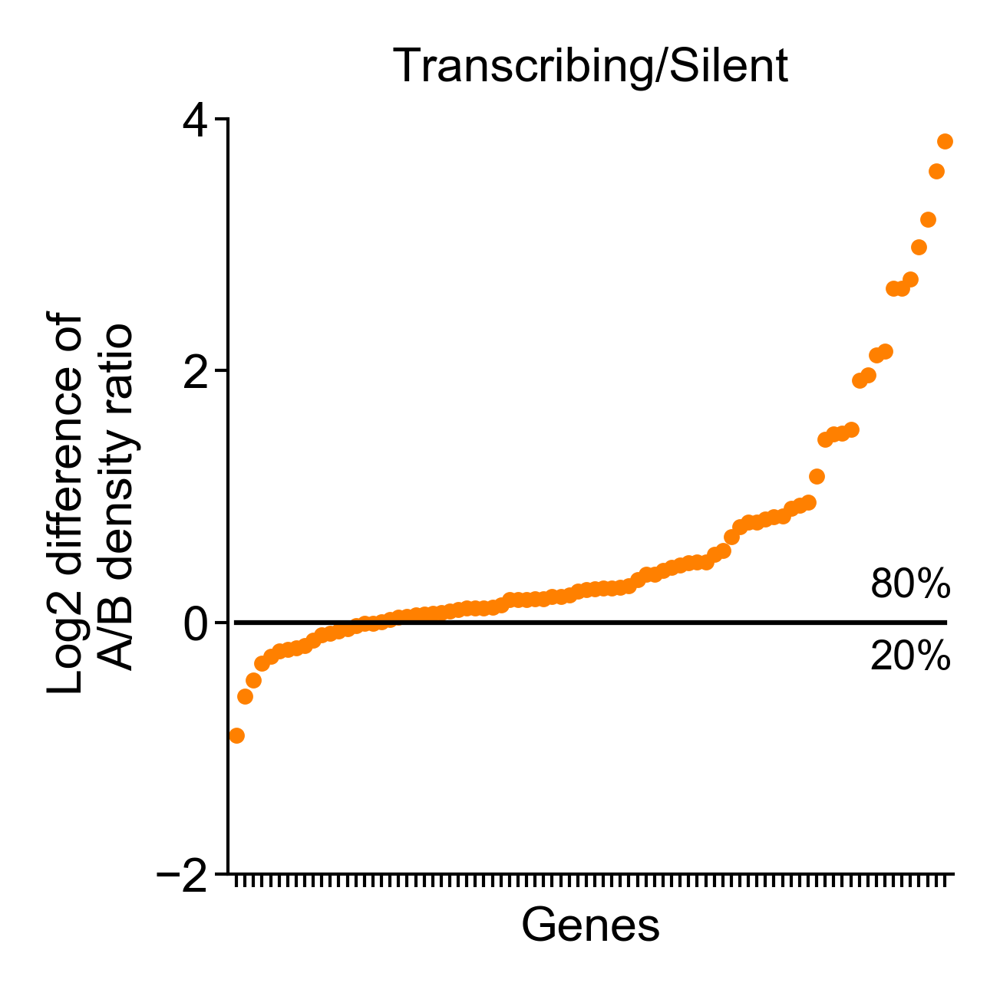

In [181]:
gene_density_dicts = data_combined['gene_density_scores']
gene_A_scores = np.array([_gsd['A'] for _gsd in gene_density_dicts])
gene_B_scores = np.array([_gsd['B'] for _gsd in gene_density_dicts])

trans_pfs = np.array(data_combined['trans_pfs'])

on_gene_AB_ratio, off_gene_AB_ratio = [], []
on_gene_total_density = []
off_gene_total_density = []

for _gind in range(gene_A_scores.shape[1]):
    # extract AB and transcription
    _a_scores = gene_A_scores[:, _gind]
    _b_scores = gene_B_scores[:, _gind]
    _transcriptions = trans_pfs[:,_gind]
    # get AB ratio
    _log_ab_ratios = np.log(_a_scores)/np.log(2) - np.log(_b_scores)/np.log(2)
    _total_density =  _a_scores+_b_scores
    # append
    on_gene_AB_ratio.append(np.nanmedian(_log_ab_ratios[_transcriptions & (np.isinf(_log_ab_ratios)==False)]))
    off_gene_AB_ratio.append(np.nanmedian(_log_ab_ratios[~_transcriptions & (np.isinf(_log_ab_ratios)==False)]))
    on_gene_total_density.append(np.nanmedian(_total_density[_transcriptions & (np.isinf(_total_density)==False)]))
    off_gene_total_density.append(np.nanmedian(_total_density[~_transcriptions & (np.isinf(_total_density)==False)]))


# convert into arrays
on_gene_AB_ratio = np.array(on_gene_AB_ratio)
off_gene_AB_ratio = np.array(off_gene_AB_ratio)
on_gene_total_density = np.array(on_gene_total_density)
off_gene_total_density = np.array(off_gene_total_density)

gene_ratio_diff = on_gene_AB_ratio - off_gene_AB_ratio

fig, ax = plt.subplots(figsize=(_single_col_width, _single_col_width),dpi=600)

ax.plot(np.sort(gene_ratio_diff), '.', color=[1,0.5,0], label='All genes', markersize=3)
ax.plot(np.zeros(len(gene_ratio_diff)), 'black', label='ref', linewidth=0.75)

ax.tick_params('both', labelsize=_font_size, width=_ticklabel_width, length=_ticklabel_size, pad=1) 
        
        # remove bottom ticklabels for ax
[i[1].set_linewidth(_ticklabel_width) for i in ax.spines.items()]

ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

ax.set_xticks(np.arange(len(gene_ratio_diff)))
ax.set_yticks(np.arange(-6,6,2))
ax.set_xticklabels([])
ax.set_xlabel('Genes', fontsize=_font_size, labelpad=2)
ax.set_ylabel('Log2 difference of \nA/B density ratio', fontsize=_font_size, labelpad=2)
ax.set_xlim([-1, len(gene_ratio_diff)])
ax.set_ylim([-2,4])

#ax.legend(fontsize=_font_size, framealpha=1, loc='upper left')
ax.text(len(gene_ratio_diff), max(ax.get_ylim())/30, f'{np.round(np.mean(gene_ratio_diff>0),2)*100:.0f}%', 
        fontsize=_font_size-1, verticalalignment='bottom', horizontalalignment='right',)
ax.text(len(gene_ratio_diff), -max(ax.get_ylim())/30, f'{np.round(np.mean(gene_ratio_diff<0),2)*100:.0f}%', 
        fontsize=_font_size-1, verticalalignment='top', horizontalalignment='right',)

ax.set_title("Transcribing/Silent", fontsize=_font_size)
plt.gcf().subplots_adjust(left=0.2, bottom=0.15)

plt.savefig(os.path.join(figure_folder, 'Fig2H_diff_abratio_w-wo_transcribe_combined.pdf'), transparent=True)

plt.show()

<a id='3.6'></a>
## 3.6 firing rate difference with high/low A/B density ratio

(Fig2I)

E:\Users\puzheng\anaconda3\lib\site-packages\ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in log
  if sys.path[0] == '':
E:\Users\puzheng\anaconda3\lib\site-packages\ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in true_divide
  if sys.path[0] == '':
E:\Users\puzheng\anaconda3\lib\site-packages\ipykernel_launcher.py:12: RuntimeWarning: overflow encountered in true_divide
  if sys.path[0] == '':


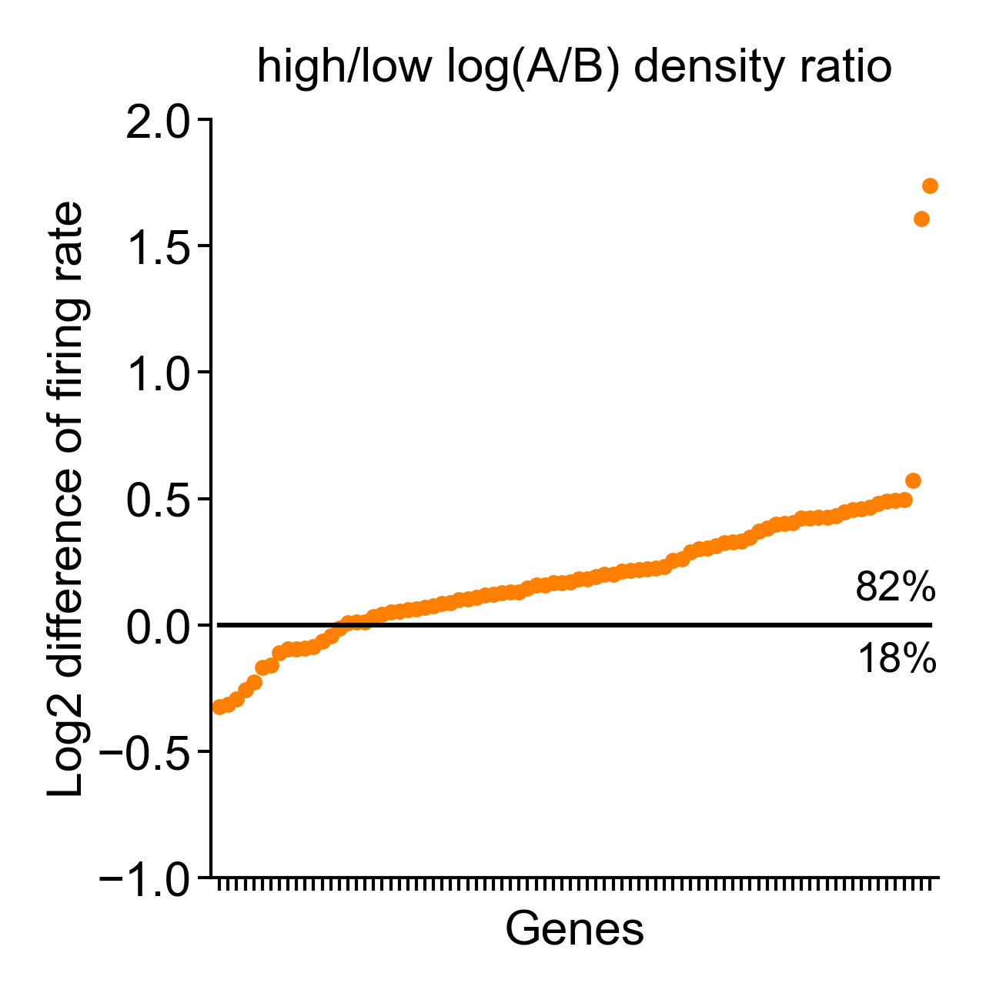

In [182]:
gene_density_dicts = data_combined['gene_density_scores']
gene_A_scores = np.array([_gsd['A'] for _gsd in gene_density_dicts])
gene_B_scores = np.array([_gsd['B'] for _gsd in gene_density_dicts])

trans_pfs = np.array(data_combined['trans_pfs'])

abratio_ratio = []
for _gid in np.arange(trans_pfs.shape[1]):
    # extract info
    _ga = gene_A_scores[:,_gid]
    _gb = gene_B_scores[:,_gid]
    _gratio = np.log(_ga / _gb) 
    
    # sel_inds
    _inds = np.argsort(_gratio)
    _sel_v = np.where((np.isnan(_gratio)==False) * (np.isinf(_gratio)==False))[0]
    _sel_inds = np.array([_i for _i in _inds if _i in _sel_v], dtype=np.int)
    
    _li = _sel_inds[:int(len(_sel_inds)/4)]
    _hi = _sel_inds[-int(len(_sel_inds)/4):]
    #print(len(_sel_inds), np.mean(_gratio[_li]), np.mean(_gratio[_hi]))
    _lfr = np.nanmean(trans_pfs[_li, _gid])
    _hfr = np.nanmean(trans_pfs[_hi, _gid])
    abratio_ratio.append(_hfr / _lfr)

abratio_fr_ratio = np.log(np.array(abratio_ratio)) / np.log(2)

fig, ax = plt.subplots(figsize=(_single_col_width, _single_col_width),dpi=600)

#ax.plot(np.arange(len(sel_A_gene_inds)), 
#        np.sort(np.log(abratio_ratio[sel_A_gene_inds])), 
#        'r.', label='A genes', markersize=3)
#ax.plot(np.arange(len(sel_A_gene_inds),len(sel_A_gene_inds)+len(sel_B_gene_inds)), 
#         np.sort(np.log(abratio_ratio[sel_B_gene_inds])), 
#        'b.', label='B genes', markersize=3)

ax.plot(np.sort(abratio_fr_ratio), 
        '.', color=[1,0.5,0], label='All genes', markersize=3)
ax.plot(np.zeros(len(abratio_fr_ratio)), 
        'black', label='reference', linewidth=0.75)

ax.tick_params('both', labelsize=_font_size, 
                width=_ticklabel_width, length=_ticklabel_size,
                pad=1) # remove bottom ticklabels for ax1
ax.set_xticks(np.arange(len(abratio_fr_ratio)))
ax.set_xticklabels([])
ax.set_ylabel('Log odds ratio', fontsize=_font_size, labelpad=1)
ax.set_xlim([-1, len(abratio_fr_ratio)])
ax.set_ylim([-1,2])

[i[1].set_linewidth(_ticklabel_width) for i in ax.spines.items()]
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

ax.set_xlabel('Genes', fontsize=_font_size, labelpad=2)
ax.set_ylabel('Log2 difference of firing rate', fontsize=_font_size, labelpad=1)
ax.set_title(f"high/low log(A/B) density ratio", 
             fontsize=_font_size)

#ax.legend(fontsize=_font_size, framealpha=1, loc='upper left')

ax.text(len(abratio_fr_ratio), max(ax.get_ylim())/30, f'{np.round(np.mean(abratio_fr_ratio>0),2)*100:.0f}%', 
        fontsize=_font_size-1, verticalalignment='bottom', horizontalalignment='right',)
ax.text(len(abratio_fr_ratio), -max(ax.get_ylim())/30, f'{np.round(np.mean(abratio_fr_ratio<=0),2)*100:.0f}%', 
        fontsize=_font_size-1, verticalalignment='top', horizontalalignment='right',)

plt.gcf().subplots_adjust(left=0.2, bottom=0.15)

plt.savefig(os.path.join(figure_folder, f"Fig2I_firing-rate_diff_w_high-low_abratio_combined.pdf"), transparent=True)

plt.show()

<a id='4'></a>
# 4. Characterization of compartments in G1, G2/S cells

This is specifically in replicate 2 because only this sample has geminin immunofluorescence labelling

<a id='4.1'></a>
## 4.1 calculate A,B density scores for replicate 2

In [26]:
import multiprocessing as mp
import time
num_threads=32
density_var = 108 # nm

# density score for 50kb genomic regions
_dna_density_args = [(_zxys,_zxys, data_combined['AB_dict'], [density_var,density_var,density_var], True) 
                     for _zxys in data_rep2['dna_zxys']]
_dna_density_time = time.time()

print(f"Multiprocessing calculate dna_density_scores", end=' ')
if 'dna_density_scores' not in data_rep2:
    with mp.Pool(num_threads) as dna_density_pool:
        dna_density_dicts = dna_density_pool.starmap(ia.compartment_tools.scoring.spot_density_scores, _dna_density_args)
        dna_density_pool.close()
        dna_density_pool.join()
        dna_density_pool.terminate()
    # save
    data_rep2['dna_density_scores'] = dna_density_dicts
print(f"in {time.time()-_dna_density_time:.3f}s.")

Multiprocessing calculate dna_density_scores in 26.692s.


<a id='4.2'></a>
## 4.2 calculate segregation scores for G1,G2/S chromosomes

(FigS2D)

In [27]:
def randomize_AB_dict(AB_dict):
    all_regs = np.sort(np.concatenate(list(AB_dict.values())))
    AB_identities = np.zeros(len(all_regs))
    AB_identities[np.array([_i for _i,_r in enumerate(all_regs) 
                            if _r in AB_dict['A']])] = 1
    # randomize new start
    new_start = np.random.randint(0, len(all_regs))
    new_AB_identities = np.concatenate([AB_identities[new_start:], AB_identities[:new_start]])
    # recreate AB_dict
    new_AB_dict = {'A': np.sort(all_regs[np.where(new_AB_identities==1)[0]]),
                   'B': np.sort(all_regs[np.where(new_AB_identities==0)[0]]),}
    return new_AB_dict

# calculate dynamic fraction scores
from scipy.stats import scoreatpercentile

AB_identities_rep2 = np.ones(len(data_rep2['dna_zxys'][0])) * np.nan
AB_identities_rep2[data_combined['AB_dict']['A']] = 1
AB_identities_rep2[data_combined['AB_dict']['B']] = 0

# calculate re-thresholded fraction scores
A_fracs, B_fracs = [], []
A_ths, B_ths = [], []
cloud_th_per=67
for _sd in tqdm(data_rep2['dna_density_scores']):
    # define A,B threshold based on their own densities
    _A_th = scoreatpercentile(_sd['A'][data_combined['AB_dict']['A']], 100-cloud_th_per)
    _B_th = scoreatpercentile(_sd['B'][data_combined['AB_dict']['B']], 100-cloud_th_per)
    # calculate purity within A,B clouds
    A_fracs.append(np.nanmean(AB_identities_rep2[np.where(_sd['A'] >= _A_th)[0]]))
    B_fracs.append(1-np.nanmean(AB_identities_rep2[np.where(_sd['B'] >= _B_th)[0]]))
    # store AB thresholds for references
    A_ths.append(_A_th)
    B_ths.append(_B_th)
# calculate re-thresholded fraction scores
rand_A_fracs, rand_B_fracs = [], []

for _sd in tqdm(data_rep2['dna_density_scores']):
    # randomize AB dict
    _rand_AB_dict = randomize_AB_dict(data_combined['AB_dict'])
    _rand_A_inds, _rand_B_inds = np.array(_rand_AB_dict['A']), np.array(_rand_AB_dict['B'])
    # generate randomized AB_identities_rep2 vector for purity calculation
    _rand_AB_identities_rep2 = np.ones(len(data_rep2['dna_zxys'][0])) * np.nan
    _rand_AB_identities_rep2[_rand_AB_dict['A']] = 1
    _rand_AB_identities_rep2[_rand_AB_dict['B']] = 0
    # define A,B threshold based on their own densities
    _A_th = scoreatpercentile(_sd['A'][_rand_A_inds], 100-cloud_th_per)
    _B_th = scoreatpercentile(_sd['B'][_rand_B_inds], 100-cloud_th_per)
    # calculate purity within A,B clouds
    rand_A_fracs.append(np.nanmean(_rand_AB_identities_rep2[np.where(_sd['A'] >= _A_th)[0]]))
    rand_B_fracs.append(1-np.nanmean(_rand_AB_identities_rep2[np.where(_sd['B'] >= _B_th)[0]]))

# Save
data_rep2['segregation_scores'] = (np.array(A_fracs) + np.array(B_fracs)) / 2
data_rep2['randomized_segregation_scores'] = (np.array(rand_A_fracs) + np.array(rand_B_fracs)) / 2

E:\Users\puzheng\anaconda3\lib\site-packages\ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in greater_equal
E:\Users\puzheng\anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: invalid value encountered in greater_equal
E:\Users\puzheng\anaconda3\lib\site-packages\ipykernel_launcher.py:30: RuntimeWarning: Mean of empty slice
E:\Users\puzheng\anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: Mean of empty slice


E:\Users\puzheng\anaconda3\lib\site-packages\ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in greater_equal
E:\Users\puzheng\anaconda3\lib\site-packages\ipykernel_launcher.py:51: RuntimeWarning: invalid value encountered in greater_equal
E:\Users\puzheng\anaconda3\lib\site-packages\ipykernel_launcher.py:50: RuntimeWarning: Mean of empty slice
E:\Users\puzheng\anaconda3\lib\site-packages\ipykernel_launcher.py:51: RuntimeWarning: Mean of empty slice


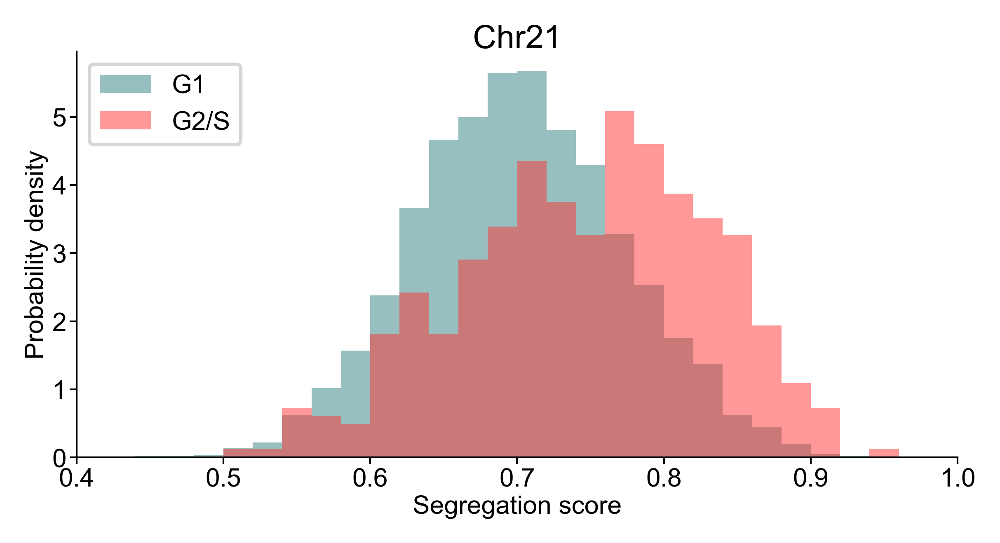

In [36]:
%matplotlib inline
fig, ax = plt.subplots(figsize=(_double_col_width, _single_col_width),dpi=600)

ax.hist(np.array(data_rep2['segregation_scores'])[np.array(data_rep2['G1_flags'])], 50, range=(0.,1), 
        density=True, alpha=0.5, 
        color=[0.2,0.5,0.5], label='G1')
ax.hist(np.array(data_rep2['segregation_scores'])[np.array(data_rep2['G2/S_flags'])], 50, range=(0.,1), 
        density=True, alpha=0.5, 
        color=[1,0.2,0.2], label='G2/S')

ax.legend(fontsize=_font_size, loc='upper left')

ax.set_xlabel("Segregation score", fontsize=_font_size, labelpad=1)
ax.set_ylabel("Probability density", fontsize=_font_size, labelpad=1)

ax.tick_params('both', labelsize=_font_size, 
                width=_ticklabel_width, length=_ticklabel_size,
                pad=1, labelleft=True) # remove bottom ticklabels for a_ax
[i[1].set_linewidth(_ticklabel_width) for i in ax.spines.items()]
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

ax.set_xlim([0.4,1])
ax.set_title('Chr21', fontsize=_font_size+2, pad=1)

plt.gcf().subplots_adjust(bottom=0.15, left=0.15)

plt.savefig(os.path.join(figure_folder, f'FigS2D_chr21_segregation_scores_G1-G2S_rep2.pdf'), transparent=True)
plt.show()

# Pileups around TSSs

In [275]:
from scipy.spatial.distance import pdist, squareform

with open('rirj_combined_list.pkl', 'rb') as f:
    rirjmap_combined_list = pickle.load(f)
    
# normalize genomic distance effects
num_loci = 651
#window size in Mb [for now make it as large as possible
offset = data_combined['mid_position_Mb'][-1] - data_combined['mid_position_Mb'][0]
#matrices where center [650, 650] is the locus containing gene(s)
distmap_on = np.zeros((2*num_loci - 1, 2*num_loci - 1))
distmap_off = np.zeros((2*num_loci - 1, 2*num_loci - 1))
rirjmap_on = np.zeros((2*num_loci - 1, 2*num_loci - 1))
rirjmap_off = np.zeros((2*num_loci - 1, 2*num_loci - 1))
counts_on = np.zeros((2*num_loci - 1, 2*num_loci - 1))
counts_off = np.zeros((2*num_loci - 1, 2*num_loci - 1))

for i in tqdm(range(len(data_combined['dna_zxys']))):
    distmap = distmap_combined_list[i] #651 by 651 matrix
    rirjmap = rirjmap_combined_list[i] #651 by 651 matrix
    #convert nans to zero
    distmap[np.isnan(distmap)] = 0
    rirjmap[np.isnan(rirjmap)] = 0
    #find all the gene loci
    on_gene_inds = np.where(data_combined['gene_state'][i] == 1)[0]
    off_gene_inds = np.where(data_combined['gene_state'][i] == -1)[0]
    assert(len(on_gene_inds) + len(off_gene_inds) == 80)
    for oni in on_gene_inds:
        #window bounds
        #left_bound = np.max(data_combined['mid_position_Mb'][oni] - offset, data_combined['mid_position_Mb'][0])
        #left_idx = (np.abs(data_combined['mid_position_Mb'] - left_bound)).argmin()
        #right_bound = np.min(data_combined['mid_position_Mb'][oni] + offset, data_combined['mid_position_Mb'][0])
        #right_idx = (np.abs(data_combined['mid_position_Mb'] - right_bound)).argmin()
        #NOTE: this is wrong, it assumes each bin is the same, but they are not translationally invariant. cannot just shift!
        #TODO: devise a binning procedure to aggregate distances with fixed binsize
        distmap_on[(num_loci - 1 - oni):(2*num_loci -1 - oni), (num_loci - 1 - oni):(2*num_loci -1 - oni)] += distmap
        rirjmap_on[(num_loci - 1 - oni):(2*num_loci -1 - oni), (num_loci - 1 - oni):(2*num_loci -1 - oni)] += rirjmap
        #keep track of the number of distance computations in each pixel
        counts_on[(num_loci - 1 - oni):(2*num_loci -1 - oni), (num_loci - 1 - oni):(2*num_loci -1 - oni)] += 1
    for offi in off_gene_inds:
        distmap_off[(num_loci - 1 - offi):(2*num_loci -1 - offi), (num_loci - 1 - oni):(2*num_loci -1 - oni)] += distmap
        rirjmap_off[(num_loci - 1 - offi):(2*num_loci -1 - offi), (num_loci - 1 - oni):(2*num_loci -1 - oni)] += rirjmap
        #keep track of the number of distance computations in each pixel
        counts_off[(num_loci - 1 - offi):(2*num_loci -1 - offi), (num_loci - 1 - oni):(2*num_loci -1 - oni)] += 1

#mean
distmap_off /= counts_off
rirjmap_off /= counts_off
distmap_on /= counts_on


  0%|          | 0/12149 [00:00<?, ?it/s]

/tmp/ipykernel_11492/2234523809.py:45: RuntimeWarning: invalid value encountered in true_divide
  distmap_off /= counts_off
/tmp/ipykernel_11492/2234523809.py:46: RuntimeWarning: invalid value encountered in true_divide
  rirjmap_off /= counts_off
/tmp/ipykernel_11492/2234523809.py:47: RuntimeWarning: invalid value encountered in true_divide
  distmap_on /= counts_on


NameError: name 'count_on' is not defined

In [276]:
rirjmap_on /= counts_on

/tmp/ipykernel_11492/3025055787.py:1: RuntimeWarning: invalid value encountered in true_divide
  rirjmap_on /= counts_on


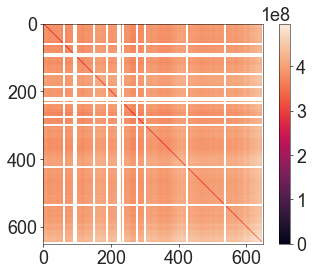

In [283]:
fig, ax = plt.subplots()
im = ax.imshow(rirjmap_combined_list[100])
plt.colorbar(im)

In [ ]:
#mean squared separation from rirj
rirj = rirjmap_combined_list[100]
#ri^2 - 2rirj + rj^2
rsquared = np.diag(rirj).reshape((num_loci, 1))
ri2 = np.tile(rsquared, (1, num_loci))
rj2 = np.tile(rsquared.T, (num_loci, 1))
mean_squared_separation = ri2 - 2*rirj + rj2
fig, ax = plt.subplots()
im = ax.imshow(mean_squared_separation)
plt.colorbar(im)

In [2]:
rirjmap_combined_list

NameError: name 'rirjmap_combined_list' is not defined

In [302]:
np.tile(x, (1,4))

array([[0.15153494, 0.15153494, 0.15153494, 0.15153494],
       [0.36753725, 0.36753725, 0.36753725, 0.36753725],
       [0.65111778, 0.65111778, 0.65111778, 0.65111778],
       [0.4414833 , 0.4414833 , 0.4414833 , 0.4414833 ]])

In [303]:
np.tile(x.T, (4,1))

array([[0.15153494, 0.36753725, 0.65111778, 0.4414833 ],
       [0.15153494, 0.36753725, 0.65111778, 0.4414833 ],
       [0.15153494, 0.36753725, 0.65111778, 0.4414833 ],
       [0.15153494, 0.36753725, 0.65111778, 0.4414833 ]])